# Project 2: SCOTLAND ROAD TRAFFIC DATA ANALYSIS



The analysis is focused on Scotland's underlying transport logistics, and is divided into 3 parts:

| Section 1: Wheels in Motion | Section 2: Busiest Road | Section 3: The Anglo-Scottish Border |
|:--:|:--:|:--:|
| <img src="images/section1.jpg" alt="Task 2 example" style="width: 500px;"/> | <img src="images/section2.jpg" alt="Task 2 example" style="width: 500px;"/> | <img src="images/section3.jpg" alt="Task 2 example" style="width: 500px;"/> |

---

First of all, we make sure to install all libraries from the requirements.txt file.

In [1]:
%pip install -r requirements.txt

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.0 -> 25.0.1
[notice] To update, run: C:\Users\loren\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


---
# 🚩Section 1 
# Wheels in Motion (WIM): A COVID-Era Analysis of Scotland’s Vehicle Density and Mobility Trends
---

**Outline:**
1. Vehicle Density Trends by Type in Scotland.
2. Bicycle Activity Analysis: Did COVID-19 Encourage Outdoor Exercise?
3. Heavy Vehicle Trends: Did Transport Operations Continue During COVID-19?
4. Spatial Density Analysis Using Maps and Google Mobility Data 

🚩**Overview:**

The COVID-19 pandemic significantly altered vehicle density and mobility trends in Scotland, as well as broader societal behavior. Pre-pandemic, traffic volumes across all motor vehicles showed consistent growth, with "cars and taxis" dominating at 70% of traffic. However, the onset of COVID-19 in 2020 caused a sharp decline in traffic volumes due to strict social restrictions and lockdowns. While traffic for heavy goods vehicles (HGVs) remained relatively stable due to the essential nature of logistics, "pedal cycles" experienced unprecedented growth, driven by a shift toward outdoor exercise and safe, sustainable transportation alternatives. This trend was supported by government investments in cycling infrastructure, demonstrating a long-term behavioral shift toward more eco-friendly transport modes.

Mobility patterns, as analyzed through Google data, further highlight these changes. Workplaces and transit stations saw drastic drops in mobility due to work-from-home policies and reduced public transport reliance. Conversely, residential areas experienced increased activity, reflecting the shift to home-based routines. Interestingly, parks became crucial outdoor spaces for exercise, aligning with a spike in pedal cycle usage during stricter lockdowns. These mobility shifts illustrate how societal priorities adapted, with a stronger focus on health, safety, and sustainable practices during and after the pandemic. 

---

## 1.1 Vehicle Density Trends by Type in Scotland
✅ Analyze how the density of different vehicle types (cars, motorcycles, bicycles, heavy vehicles, etc.) has evolved in Scotland over time.

✅ We are trying to reproduce the graph of vehicle density by type as published by the the Department for Transport (DfT) and investigate any patterns


---
### Reproducing the graph of vehichles density by type 
We have implemented the visualization of line charts showing the number of various vehicle types in Scotland using only manual count data. In our project, we focused exclusively on analyzing all major roads in Scotland.

##### `Methodology:`
- First, an empty DataFrame is created to store intermediate processing results, and raw data is read from a CSV file. The data is filtered based on road type to select entries categorized as "Major."

- Next, the data is grouped by count_point_id and year to calculate the annual average traffic volume for various vehicle types. This information is combined with road length data to generate summary data, and missing years are filled in.

- Then, interpolation (forward fill and backward fill) is applied to handle missing values, ensuring that the data for each count_point_id is continuous over the time series. Following this, traffic volume data for each vehicle type is adjusted proportionally based on road length.

- Finally, data from all count points is aggregated by year to generate annual trends. Adjustments are made using a correction factor for specific year (2020), and the trend chart is plotted to visualize the results.

In [2]:
import pandas as pd
import os
import numpy as np
import matplotlib.pyplot as plt

# Preparing the data from Department for Transport (DfT) website to get traffic data by region, especially for Scotland 
def read_data(filename):
    '''
    Download and/or read data file.
    '''

    if os.path.exists(filename):
        traffic_info = pd.read_csv(filename)
    else:
        print('Downloading the file...')
        url = f'https://storage.googleapis.com/dft-statistics/road-traffic/downloads/rawcount/region_id/dft_rawcount_region_id_3.csv'
        traffic_info = pd.read_csv(url)

        # Save the file
        traffic_info.to_csv(filename)
    
    return traffic_info


data_reg = read_data('traffic_data_by_region')

C:\Users\loren\AppData\Local\Temp\ipykernel_28308\3021312909.py:17: DtypeWarning: Columns (11,12) have mixed types. Specify dtype option on import or set low_memory=False.
  traffic_info = pd.read_csv(url)


#### `Step 1: Data preprocessing`

This section of the code processes traffic data from a CSV file by focusing on major roads. 

It starts by creating an empty DataFrame (`data_2`) to store intermediate results, which include road information (such as link length in    kilometers and miles) and various vehicle data (such as pedal cycles, motor vehicles, and heavy goods vehicles). 

The raw data is then read from the 'dft.csv' file, and the code filters out data related to major roads (those marked as 'Major') for    further processing. 

For each unique count point (measurement location) in the major roads dataset, the code computes the annual average values for various vehicle types. 

The results are then combined with the associated road length information and stored in the `data_2` DataFrame.

Missing years (from 2001 to 2023) for each count point are filled in by adding rows with NaN values for those years. 

After all processing, the final dataset is saved to a new CSV file, 'data_2.csv'.

In [3]:
# # Create an empty DataFrame to store intermediate results
data_2 = pd.DataFrame(data=None, columns=[
    'count_point_id', 'year', 'link_length_km', 'link_length_miles',
    'pedal_cycles', 'two_wheeled_motor_vehicles', 'cars_and_taxis',
    'buses_and_coaches', 'lgvs', 'all_hgvs', 'all_motor_vehicles'
])

# Read the raw data from a CSV file
data = read_data('traffic_data_by_region')

# Filter out major road data
data_major = data[data['road_type'] == 'Major']

df_clear = data_major
# Get unique count point IDs from major roads
all_cp = data_major['count_point_id'].unique()

# Process data for each count point
for aim_cp in all_cp:
    # Filter data for the current count point
    data_aim_cp = data_major[data_major['count_point_id'] == aim_cp]
    
    # Get all unique years for the current count point
    all_year = data_aim_cp['year'].unique()
    
    # Calculate annual averages for each year and save results
    for year in all_year:
        selected_data = data_major[
            (data_major['year'] == year) &
            (data_major['count_point_id'] == aim_cp)
        ]
        meann = selected_data[
            ['pedal_cycles', 'two_wheeled_motor_vehicles', 'cars_and_taxis',
             'buses_and_coaches', 'lgvs', 'all_hgvs', 'all_motor_vehicles']
        ].mean()
        length_kms = selected_data.iloc[0]['link_length_km']
        length_miles = selected_data.iloc[0]['link_length_miles']
        
        # Combine calculated averages and additional data into a single row
        series_1 = pd.Series(
            [aim_cp, year, length_kms, length_miles],
            index=['count_point_id', 'year', 'link_length_km', 'link_length_miles']
        )
        series_2 = pd.Series(
            meann * 48,
            index=['pedal_cycles', 'two_wheeled_motor_vehicles', 'cars_and_taxis',
                   'buses_and_coaches', 'lgvs', 'all_hgvs', 'all_motor_vehicles']
        )
        series_3 = pd.concat([series_1, series_2]).to_frame().T
        data_2 = pd.concat([data_2, series_3], axis=0)

# Fill in missing years for each count point by adding rows with NaN values
for aim_cp in all_cp:
    data_aim = data_2[data_2['count_point_id'] == aim_cp]
    all_year = data_aim['year'].unique()
    for year in range(2001, 2024):
        if year not in all_year:
            
            # Add a row with missing values for the missing year
            series_add = pd.DataFrame({
                'count_point_id': data_aim.iloc[0]['count_point_id'],
                'year': year,
                'link_length_km': data_aim.iloc[0]['link_length_km'],
                'link_length_miles': data_aim.iloc[0]['link_length_miles'],
                'pedal_cycles': None,
                'two_wheeled_motor_vehicles': None,
                'cars_and_taxis': None,
                'buses_and_coaches': None,
                'lgvs': None,
                'all_hgvs': None,
                'all_motor_vehicles': None,
            }, index=[0])
            data_2 = pd.concat([data_2, series_add], axis=0)

# Save processed data to a CSV file
data_2.to_csv('data_2.csv', index=False)
print("The data preprocessing is complete and saved to data_2.csv.")

C:\Users\loren\AppData\Local\Temp\ipykernel_28308\3021312909.py:13: DtypeWarning: Columns (12,13) have mixed types. Specify dtype option on import or set low_memory=False.
  traffic_info = pd.read_csv(filename)
C:\Users\loren\AppData\Local\Temp\ipykernel_28308\1909955564.py:50: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  data_2 = pd.concat([data_2, series_3], axis=0)
C:\Users\loren\AppData\Local\Temp\ipykernel_28308\1909955564.py:73: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  data_2 = pd.co

The data preprocessing is complete and saved to data_2.csv.


#### `Step 2: Interpolation to fill missing values`

This section of the code handles the interpolation of missing data for traffic data that was previously processed. 

It begins by creating an empty DataFrame (`data_3`) to store the interpolated data, which includes road and vehicle information.
The processed data from Step 1 (`data_2.csv`) is then read into a new DataFrame.

For each unique count point (measurement location), the data is sorted by year and missing values are filled using both forward fill (`ffill`) and backward fill (`bfill`) methods.

After performing the interpolation for all count points, the updated data is appended to `data_3`.

Finally, the interpolated dataset is saved to a new CSV file (`data_3.csv`), completing the interpolation process.

In [4]:
# Create an empty DataFrame for storing interpolated data
data_3 = pd.DataFrame(data=None, columns=[
    'count_point_id', 'year', 'link_length_km', 'link_length_miles',
    'pedal_cycles', 'two_wheeled_motor_vehicles', 'cars_and_taxis',
    'buses_and_coaches', 'lgvs', 'all_hgvs', 'all_motor_vehicles'
])

# Read the data processed in Step 1
data = pd.read_csv('data_2.csv')

# Interpolate missing data for each count point
all_cp = data['count_point_id'].unique()
for aim_cp in all_cp:
    data_aim_cp = data[data['count_point_id'] == aim_cp]
    data_aim_cp.sort_values(by='year', inplace=True, ascending=True)
    data_aim_cp.ffill(axis=0, inplace=True)  # Forward fill
    data_aim_cp.bfill(axis=0, inplace=True)  # Backward fill
    
     # Append the interpolated data
    data_3 = pd.concat([data_3, data_aim_cp])

# Save the interpolated data to a CSV file
data_3.to_csv('data_3.csv', index=False)
print("The interpolation process is complete and saved to data_3.csv.")

C:\Users\loren\AppData\Local\Temp\ipykernel_28308\2213055419.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_aim_cp.sort_values(by='year', inplace=True, ascending=True)
C:\Users\loren\AppData\Local\Temp\ipykernel_28308\2213055419.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_aim_cp.ffill(axis=0, inplace=True)  # Forward fill
C:\Users\loren\AppData\Local\Temp\ipykernel_28308\2213055419.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning

The interpolation process is complete and saved to data_3.csv.


#### `Step 3: Calculate the factor for 2020`

This section of the code handles the differences between traffic data in 2020 and normal years, with a focus on analyzing the data changes at specific count points in 2020.

First, the data for 2020 is extracted from the dataset, and the count point IDs that have data for 2020 `(all_cp_have2020)` are filtered.

Then, the ratio of total motor vehicles in 2020 compared to a "normal" year (e.g., 2016) for common count point is calculated, resulting in a decrease factor (factor_motor) to represent the decrease in motor vehicle numbers. We chose 2016 because there are more common count point with data for both 2016 and 2020, minimize the randomness of using data from only a specific count point. Additionally, the data from 2016 is similar to other normal years, making it suitable for extrapolation.

Similarly, the ratio of pedal cycles between 2020 and a normal year at a selected count point is calculated, leading to an increase factor `(factor_cycle)` to represent the increase in pedal cycle numbers in 2020.

These calculations provide the basis for filling in the missing data for 2020, especially in cases where some road sections were not counted in 2020. By estimating the changes observed across different count points, the interpolation results are adjusted accordingly.

Ultimately, these ratio factors will be used to adjust the data for road sections not counted in 2020, ensuring the data more accurately reflects real-world changes, especially when accounting for statistical differences caused by special factors like the covid-19.

In [5]:
# Filter data for the years 2016 and 2020
data_2016 = data_major[data_major['year'] == 2016]
data_2020 = data_major[data_major['year'] == 2020]

# Get unique count_point_id for 2016 and 2020
cp_2016 = set(data_2016['count_point_id'].unique())
cp_2020 = set(data_2020['count_point_id'].unique())

# Find the intersection of count_point_id between 2016 and 2020
common_cp = cp_2016.intersection(cp_2020)

# Print the common count_point_id
print("Roads with 2020  and 2016 data (count_point_id):", common_cp)


# Compute the factor for the decrease in motor vehicle numbers in 2020. 
# Filter normal year (2016) data and special year (2020) data for roads in common_cp
data_normal = df_clear[(df_clear['year'] == 2016) & (df_clear['count_point_id'].isin(common_cp))]
data_special = df_clear[(df_clear['year'] == 2020) & (df_clear['count_point_id'].isin(common_cp))]

# Compute total motor vehicle miles for the normal year and special year
normal_vehicles_miles = data_normal['all_motor_vehicles'].sum()
special_vehicles_miles = data_special['all_motor_vehicles'].sum()

# Compute the decrease factor
factor_motor = special_vehicles_miles / normal_vehicles_miles
print('the motor vehicles decrease factor in 2020 result is',factor_motor)

# Compute the factor for the increase in pedal cycle numbers in 2020.
# Filter normal year (2016) data and special year (2020) data for roads in common_cp
data_normal = df_clear[(df_clear['year'] == 2016) & (df_clear['count_point_id'].isin(common_cp))]
data_special = df_clear[(df_clear['year'] == 2020) & (df_clear['count_point_id'].isin(common_cp))]

# Compute total pedal cycles for the normal year and special year
normal_pedal_cycles = data_normal['pedal_cycles'].sum()
special_pedal_cycles = data_special['pedal_cycles'].sum()

# Compute the decrease factor for pedal cycles
factor_cycle = special_pedal_cycles / normal_pedal_cycles
print('the pedal increase factor in 2020 result is',factor_cycle)

Roads with 2020  and 2016 data (count_point_id): {np.int64(80104), np.int64(80446), np.int64(74285), np.int64(30962), np.int64(10750)}
the motor vehicles decrease factor in 2020 result is 0.791063283467832
the pedal increase factor in 2020 result is 2.142857142857143


#### `Step 4: Visualization`

This section of the code processes and adjusts the interpolated traffic data, then visualizes the adjusted vehicle data over time.

The code starts by reading the interpolated data (data_3.csv) and creates an empty DataFrame (data_4) to store the adjusted values. It then adjusts the traffic data by scaling it based on the link length (in miles) for each count point. The adjusted data is then aggregated by year, summing the vehicle counts for each type (e.g., buses, pedal cycles, HGVs, etc.) into a matrix (mat), which is later converted into a NumPy array (mat_array).

Next, the code applies specific adjustments for 2020 data using pre-calculated factors (factor_motor and factor_cycle), accounting for changes in traffic patterns during that year. The data is further scaled down to represent a 12-hour counting period.

The adjusted data is then plotted for each vehicle type, with the years on the x-axis and vehicle miles (in billions) on the y-axis. Each vehicle type (e.g., all motor vehicles, cars, buses, pedal cycles) is represented by a different color.

Finally, the plot is displayed, showing the annual traffic trends by vehicle type. This visualization helps to analyze traffic changes over the years, particularly highlighting the impact of 2020 adjustments.

C:\Users\loren\AppData\Local\Temp\ipykernel_28308\2488191733.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_d['buses_and_coaches'] *= k
C:\Users\loren\AppData\Local\Temp\ipykernel_28308\2488191733.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_d['pedal_cycles'] *= k
C:\Users\loren\AppData\Local\Temp\ipykernel_28308\2488191733.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See th

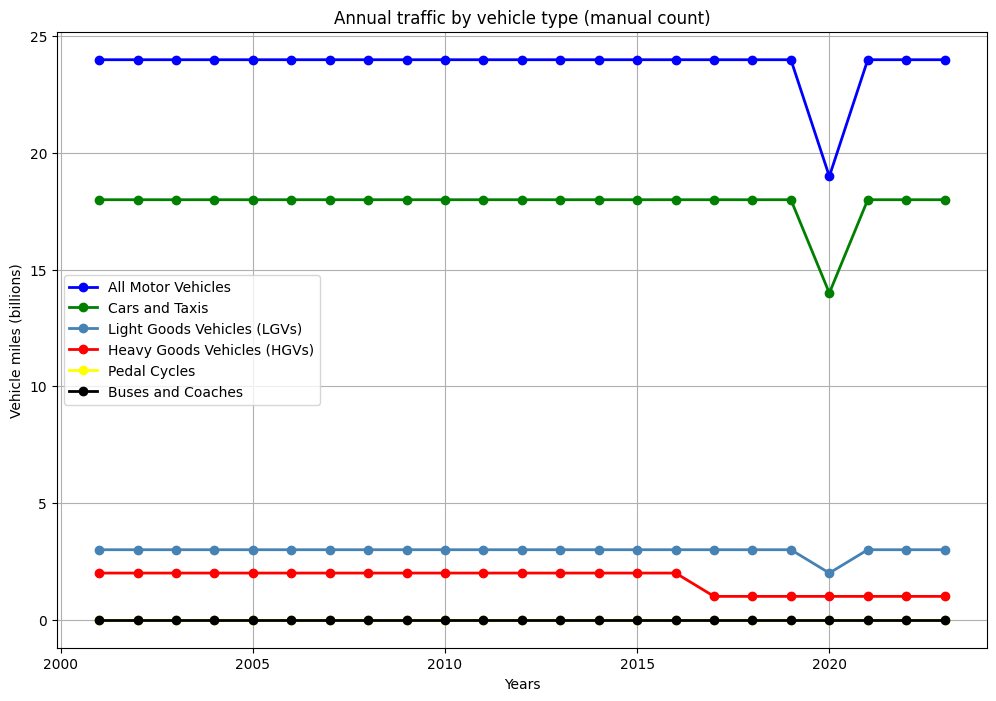

In [6]:
# Read the interpolated data
data_this = pd.read_csv('data_3.csv')

# Create an empty DataFrame to store adjusted data
data_4 = pd.DataFrame(data=None, columns=[
    'count_point_id', 'year', 'link_length_km', 'link_length_miles',
    'pedal_cycles', 'two_wheeled_motor_vehicles', 'cars_and_taxis',
    'buses_and_coaches', 'lgvs', 'all_hgvs', 'all_motor_vehicles'])

# Adjust data based on link length (in miles)
all_cp = data_this['count_point_id'].unique()
for aim_cp in all_cp:
    data_d = data_this[data_this['count_point_id'] == aim_cp]
    k = data_d.iloc[0]['link_length_miles']

    # Scale proportionally
    data_d['buses_and_coaches'] *= k
    data_d['pedal_cycles'] *= k
    data_d['all_hgvs'] *= k
    data_d['lgvs'] *= k
    data_d['cars_and_taxis'] *= k
    data_d['all_motor_vehicles'] *= k
    data_4 = pd.concat([data_4, data_d])

# Aggregate data for visualization
mat = []
for year in range(2001, 2024):
    data_aimyear = data_4[data_4['year'] == year]
    line = [
        data_aimyear['buses_and_coaches'].sum(),
        data_aimyear['pedal_cycles'].sum(),
        data_aimyear['all_hgvs'].sum(),
        data_aimyear['lgvs'].sum(),
        data_aimyear['cars_and_taxis'].sum(),
        data_aimyear['all_motor_vehicles'].sum(),
    ]
    mat.append(line)

# Convert data to a NumPy array
mat_array = np.array(mat)

# Apply adjustment for 2020 using pre-calculated factors (factor_motor and factor_cycle)
# accounting for changes in traffic patterns during that year.
mat_array = np.multiply(mat_array, 0.5)
mat_array[19] *= factor_motor
mat_array[19,1] *= factor_cycle/factor_motor

# Scale down the data (manual count for 12-hour period)
mat_array *= 0.5

# Set up the X-axis (years)(we want to show the adjusted vehicle data between 2001-2023)
x = range(2001, 2024)

# Plot data
fig = plt.figure(figsize=(12, 8))

plt.plot(x,
    
         mat_array[:,5]//1000000,  # Y-axis data (scaled by dividing by 1,000,000)
         linestyle='-',  # Line style (solid line)
         linewidth=2,  # Line width
         color='blue',  # Line color
         marker='o',  # Marker style (circle)
         markersize=6,  # Marker size
         markeredgecolor='blue',  # Marker edge color
         markerfacecolor='blue',# Marker fill color
        label='All Motor Vehicles')  

plt.plot(x,
    
         mat_array[:,4]//1000000,  # Y-axis data (scaled by dividing by 1,000,000)
         linestyle='-',  # Line style (solid line)
         linewidth=2,  # Line width
         color='green',  # Line color
         marker='o',  # Marker style (circle)
         markersize=6,  # Marker size
         markeredgecolor='green',  # Marker edge color
         markerfacecolor='green',  # Marker fill color
         label='Cars and Taxis')
plt.plot(x,
    
         mat_array[:,3]//1000000,  # Y-axis data (scaled by dividing by 1,000,000)
         linestyle='-',  # Line style (solid line)
         linewidth=2,  # Line width
         color='steelblue',  # Line color
         marker='o',  # Marker style (circle)
         markersize=6,  # Marker size
         markeredgecolor='steelblue',  # Marker edge color
         markerfacecolor='steelblue', # Marker fill color
         label='Light Goods Vehicles (LGVs)')
plt.plot(x,
    
         mat_array[:,2]//1000000,  # Y-axis data (scaled by dividing by 1,000,000)
         linestyle='-',  # Line style (solid line)
         linewidth=2,  # Line width
         color='red',  # Line color
         marker='o',  # Marker style (circle)
         markersize=6,  # Marker size
         markeredgecolor='red',  # Marker edge color
         markerfacecolor='red',  # Marker fill color
         label='Heavy Goods Vehicles (HGVs)')
plt.plot(x,
    
         mat_array[:,1]//1000000,  # Y-axis data (scaled by dividing by 1,000,000)
         linestyle='-',  # Line style (solid line)
         linewidth=2,  # Line width
         color='yellow',  # Line color
         marker='o',  # Marker style (circle)
         markersize=6,  # Marker size
         markeredgecolor='yellow',  # Marker edge color
         markerfacecolor='yellow',  # Marker fill color
         label='Pedal Cycles')
plt.plot(x,
    
         mat_array[:,0]//1000000,  # Y-axis data (scaled by dividing by 1,000,000)
         linestyle='-',  # Line style (solid line)
         linewidth=2,  # Line width
         color='black',  # Line color
         marker='o',  # Marker style (circle)
         markersize=6,  # Marker size
         markeredgecolor='black',  # Marker edge color
         markerfacecolor='black',  # Marker fill color
         label='Buses and Coaches')

# Add title and labels
plt.title('Annual traffic by vehicle type (manual count)')
plt.xlabel('Years')
plt.ylabel('Vehicle miles (billions)')

# Show legend
plt.legend()
plt.grid(True)

# Display the plot
plt.show()

Generating plot for `"Pedal Cycles"` and `"HGVs"` that will be compared with the actual graph in subsection 1.2 and 1.3

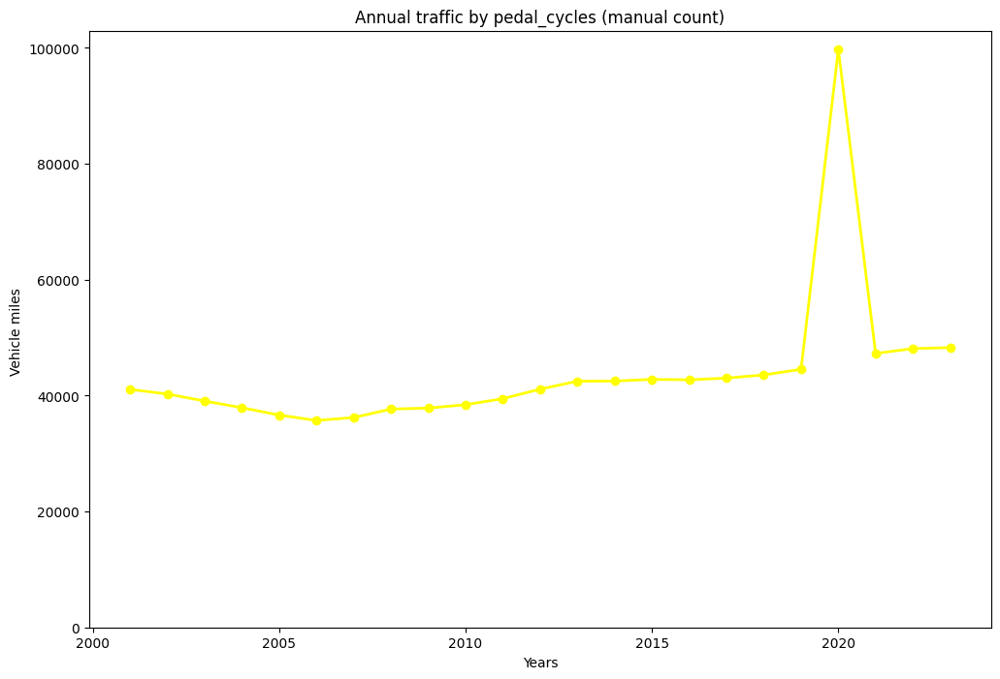

In [7]:
# Show the plot for pedal cycles
fig = plt.figure(figsize=(12, 8))
plt.plot(x,
    
         mat_array[:,1],  # Y-axis data 
         linestyle='-',  # Line style (solid line)
         linewidth=2,  # Line width
         color='yellow',  # Line color
         marker='o',  # Marker style (circle)
         markersize=6,  # Marker size
         markeredgecolor='yellow',  # Marker edge color
         markerfacecolor='yellow',  # Marker fill color
         label='Pedal Cycles')
plt.title('Annual traffic by pedal_cycles (manual count)')
plt.ylabel('Vehicle miles ')
plt.xlabel('Years')

# Set Y-axis to start from 0
plt.ylim(0)

plt.show()

Since there are still relatively few roads with data for both 2016 and 2020, there is some degree of randomness, which may have resulted in a larger cycle factor.

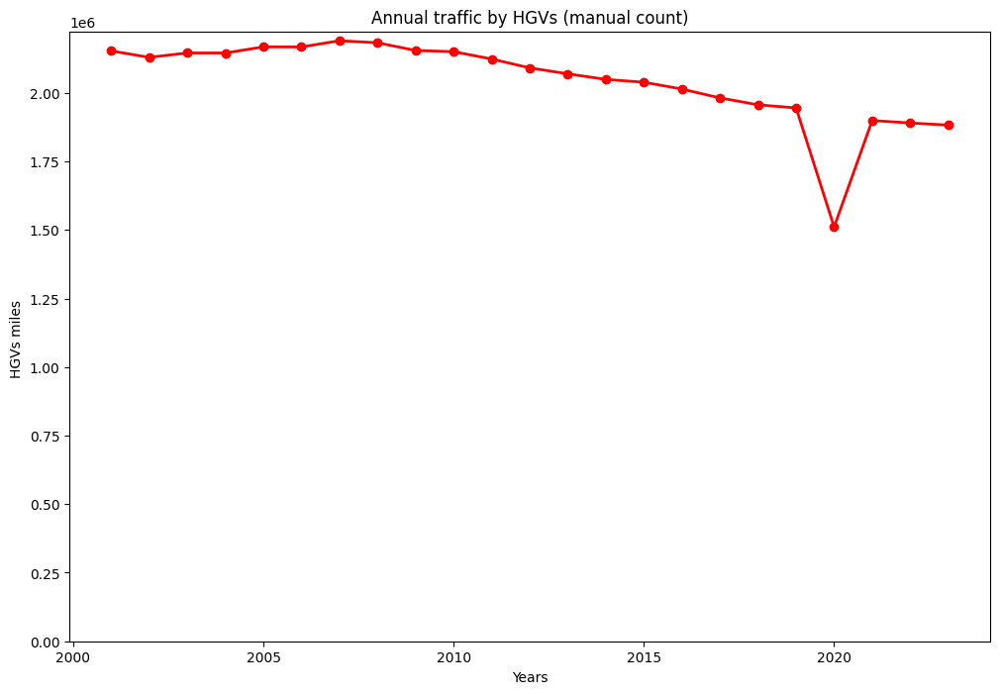

In [8]:
# Show the plot for HGVs
fig = plt.figure(figsize=(12, 8))
plt.plot(x,
    
         mat_array[:,2],  # Y-axis data (scaled by dividing by 100,000)
         linestyle='-',  # Line style (solid line)
         linewidth=2,  # Line width
         color='red',  # Line color
         marker='o',  # Marker style (circle)
         markersize=6,  # Marker size
         markeredgecolor='red',  # Marker edge color
         markerfacecolor='red',  # Marker fill color
         label='Heavy Goods Vehicles (HGVs)')
plt.title('Annual traffic by HGVs (manual count)')
plt.ylabel('HGVs miles ')
plt.xlabel('Years')

# Set Y-axis to start from 0
plt.ylim(0)

plt.show()

---
### Making Comparison with the Published Data 

In [9]:
# Generating Scotland Trafic Data 
import requests 
import pandas as pd

dat = requests.get('https://roadtraffic.dft.gov.uk/api/traffic/regions/vehicle-type?filter[region_id]=3')
traffic_data_by_type = dat.json()

# Arrange the Data into Data Frame for easier to handle, make a dictionaries for every variable that will be used for visualization from data that being generated beforehand 
traffic_data_by_type_1 = [
    {"Year": entry["year"], "All Motor Vehicles": entry["all_motor_vehicles"]/(10**9), "Cars and taxis": entry["cars_and_taxis"]/(10**9),
     "HGVs": entry["all_hgvs"]/(10**9), "Buses and coaches": entry["buses_and_coaches"]/(10**9), "LCVs": entry["lgvs"]/(10**9), 
     "Motorcycles and scooters": entry["two_wheeled_motor_vehicles"]/(10**9), "Pedal cycles": entry["pedal_cycles"]/(10**9)}
    for entry in traffic_data_by_type.get("data", [])
]

# Data now, in the data frame format that can be used easily for visualization 
df = pd.DataFrame(traffic_data_by_type_1)
print(df)

# Making a selector 
df[['Year', 'HGVs']]
# Show the data frame based on selctor by year 
selector = df['Year'] >= 2000
# print(selector)
df.loc[selector, ['Year', 'HGVs', 'LCVs']]


    Year  All Motor Vehicles  Cars and taxis    HGVs  Buses and coaches  \
0   1993             21.7093         17.6776  1.3399             0.3343   
1   1994             22.2233         18.0707  1.3658             0.3325   
2   1995             22.6774         18.4211  1.3981             0.3509   
3   1996             23.3272         18.9076  1.4341             0.3610   
4   1997             23.8276         19.2004  1.4643             0.3707   
5   1998             24.1971         19.3584  1.4986             0.3737   
6   1999             24.5641         19.6285  1.5108             0.3808   
7   2000             24.4318         19.5375  1.5139             0.3722   
8   2001             24.7486         19.8244  1.4898             0.3751   
9   2002             25.6532         20.5840  1.4963             0.3912   
10  2003             25.9662         20.6471  1.5601             0.4016   
11  2004             26.0089         20.6096  1.6171             0.3582   
12  2005             26.0

,Year,HGVs,LCVs
7,2000,1.5139,2.8530
8,2001,1.4898,2.8970
9,2002,1.4963,3.0001
10,2003,1.5601,3.1540
11,2004,1.6171,3.2355
12,2005,1.6321,3.3469
13,2006,1.6824,3.5275
14,2007,1.7202,3.7513
15,2008,1.7017,3.7632
16,2009,1.5822,3.6930


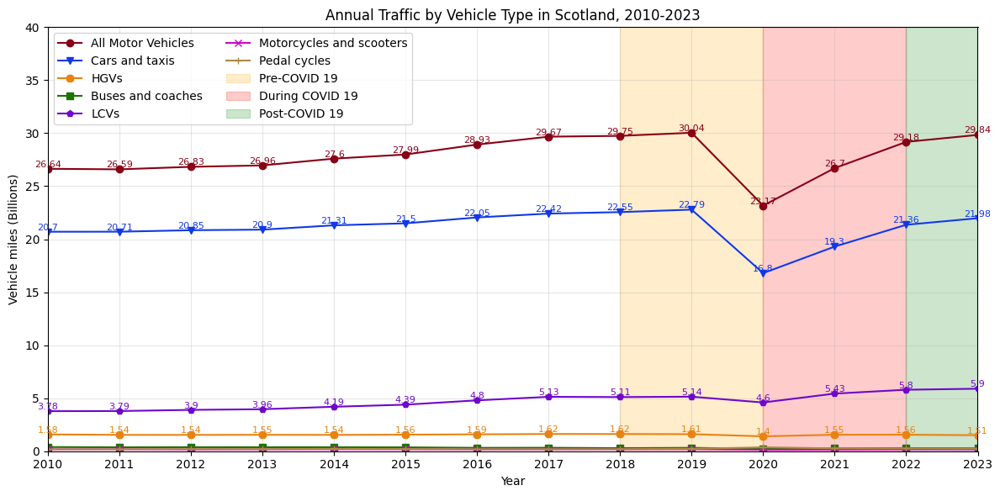

In [10]:
import matplotlib.pyplot as plt
# Making visualization of traffic data in Scotland 
# Determine the time period that will receive attention for review 
precov_year = range(2018, 2020) # focuse on 2 year before COVID-19
duringcov_year = range(2020, 2022) # COVID-19 period
postcov_year = range(2022, 2023) # post COVID-19 period

#Filtering the data start from 2010
df = df[df["Year"] >= 2010]

# Create Visualization 'Traffic data by type of vehicles', setting the plot and layout 
# We make a plot following the classification of the type of vehicles based on the Department for Transport (DfT), which are overall trafic data (All Motor Vehicles),
# Cars and taxis, HGVs (All heavy good vehicles combined), Buses and coaches, Motorcycles and scooters, and Pedal Cycles 
plt.figure(figsize=(12, 6))
plt.plot(df[["Year"]], df[["All Motor Vehicles"]], label="All Motor Vehicles", marker='o', color=(0.533, 0, 0.082))
for x, y in zip(df["Year"], df["All Motor Vehicles"]):
    plt.text(x, y, f'{round(y,2)}', fontsize=8, horizontalalignment='center', verticalalignment='bottom', color=(0.533, 0, 0.082))

plt.plot(df[["Year"]], df[["Cars and taxis"]], label="Cars and taxis", marker='v', color=(0.066, 0.219, 0.909))
for x, y in zip(df["Year"], df["Cars and taxis"]):
    plt.text(x, y, f'{round(y,2)}', fontsize=8, horizontalalignment='center', verticalalignment='bottom', color=(0.066, 0.219, 0.909))
    
plt.plot(df[["Year"]], df[["HGVs"]], label="HGVs", marker='8', color=(0.909, 0.513, 0.066))
for x, y in zip(df["Year"], df["HGVs"]):
    plt.text(x, y, f'{round(y,2)}', fontsize=8, horizontalalignment='center', verticalalignment='bottom', color=(0.909, 0.513, 0.066))
    
plt.plot(df[["Year"]], df[["Buses and coaches"]], label="Buses and coaches", marker='s', color=(0.105, 0.450, 0.007))
plt.plot(df[["Year"]], df[["LCVs"]], label="LCVs", marker='p', color=(0.435, 0.023, 0.796))
for x, y in zip(df["Year"], df["LCVs"]):
    plt.text(x, y, f'{round(y,2)}', fontsize=8, horizontalalignment='center', verticalalignment='bottom', color=(0.435, 0.023, 0.796))
    
plt.plot(df[["Year"]], df[["Motorcycles and scooters"]], label="Motorcycles and scooters", marker='x', color=(0.796, 0.023, 0.792))
plt.plot(df[["Year"]], df[["Pedal cycles"]], label="Pedal cycles", marker='+', color=(0.678, 0.545, 0.2629))

# To make spotlight on the identification, we create a shadow that indicate the time pre, during and post COVID-19 
plt.axvspan(2018, 2020, color='orange', alpha=0.2, label='Pre-COVID 19')
plt.axvspan(2020, 2022, color='red', alpha=0.2, label='During COVID 19')
plt.axvspan(2022, 2023, color='green', alpha=0.2, label='Post-COVID 19')

# Setting the axis, label and legend of the plot 
plt.title("Annual Traffic by Vehicle Type in Scotland, 2010-2023")
plt.xlabel("Year")
plt.xlim(2010, 2023)
plt.xticks(range(2010, 2024, 1))
plt.ylim(0, 40)
plt.yticks(range(0, 45, 5))
plt.ylabel("Vehicle miles (Billions)")
plt.legend(loc="best", ncol = 2, draggable = True)
plt.grid(alpha=0.3)

# Displaying the line plot with shadowing the important period based on COVID-19 analysis 
plt.tight_layout()
plt.show()


🚩 Based on the chart above, it can be observed that traffic data in Scotland generally showed an increasing trend during the pre-COVID-19 period. However, in 2020, when COVID-19 struck globally, it significantly impacted economic activities and other aspects, leading to a substantial decline in vehicle traffic volume (as seen in the "All Motor Vehicles" variable shaded in red). This drop was also influenced by social restrictions/lockdowns imposed by governments, including Scotland, which implemented social restrictions starting March 23, 2020 ([source: click this page](https://www.instituteforgovernment.org.uk/sites/default/files/timeline-lockdown-web.pdf)). As restrictions eased on 2022, public mobility increased, along with traffic volumes (shaded in green), although they had not fully recovered to pre-pandemic levels.

🚩 On the other hand, by vehicle type, "cars and taxis" accounted for the largest share of traffic volume (up to 70%) compared to other types. This pattern was consistent during the pre-COVID-19 period, with an upward trend peaking in 2019. However, traffic for this type declined during the pandemic and gradually recovered post-pandemic.

🚩 A unique trend occurred with "pedal cycles," which saw an increase in traffic during the COVID-19 pandemic and continued to show a positive trend even after the pandemic ended. This point will be discussed further in `Part 1.2.`

🚩 Meanwhile, logistics and shipping activities using HGVs (Heavy Goods Vehicles) remained relatively stable, with only a slight decline during the pandemic. This topic will be elaborated on in `Part 1.3.`


---

## 1.2. Bicycle Activity Analysis: Did COVID-19 Encourage Outdoor Exercise?
✅ Focus on bicycle (pedal) activity, particularly during the COVID-19 pandemic, to examine if there was a rise in outdoor exercise and cycling as people sought alternative activities. 

✅ reference: https://plotly.com/python/filled-area-plots/

In [11]:
import plotly 
import plotly.graph_objects as go 

# From the full set of data we analyzed specific to "pedal cycles" data, so we make filtering for pedal cycle coloumn 
# Because our idea want to show 2 vizualization on one screen, Firstly, we calculate the growth of the pedal cycle (percentage growth, year on year)
x_axis = df["Year"]
Growth_Pedal = df["Pedal cycles"].pct_change() * 100


# The code creates a dual-axis time-series visualization using Plotly to analyze traffic data and growth trends for pedal cycles. 
'''
The primary y-axis represents the traffic volume of pedal cycles, visualized as a smooth line within a stacked area chart, while the secondary y-axis shows the growth percentage, 
plotted with a distinct line and markers. Additionally, a highlighted area between 2019 and 2020 is included using a transparent red rectangle to emphasize the period, likely to indicate 
significant events or changes in trends during that timeframe.

The idea of this plot is to combined visualization effectively captures both absolute and relative changes in pedal cycle traffic over time.

'''

fig = go.Figure()
fig.add_trace(go.Scatter(
    x = x_axis, y = df["Pedal cycles"],
    name = "Traffic of Pedal cycle",
    hoverinfo='x+y',
    mode='lines',
    line=dict(width=0.5, color='rgb(131, 90, 241)'),
    stackgroup='one' 
))

fig.add_trace(go.Scatter(
    x = x_axis, y = Growth_Pedal,
    name="Growth of Pedal cycles (%)",
    hoverinfo='x+y',
    mode='lines+markers',
    line=dict(width=2, color='rgb(255, 127, 14)'),
    yaxis="y2"  # indicate secondary y-axis
))

# Add "highlight area" for 2019-2020
'''
Due to the COVID-19 pandemic, we found the unique information due to the pedal cycles that increased dramatically during pandemic. So, we highlighted this year (2019-2020),
because the percentage of growth that standout compared to the entire years. 
'''
fig.add_shape(
    type="rect",
    x0=2019, x1=2020, y0=0, y1=0.8,  
    fillcolor="rgba(255, 0, 0, 0.2)",  
    line_width=0,  
    layer="below" 
)


# Update layout for figure size, dual Y-axes, title for the graph, legend 
fig.update_layout(width=1200, height=600, title=dict(text="Annual Traffic of Pedal Cycle, 2010-2023", x=0.5,  xanchor='center', yanchor='top'),
                    xaxis=dict(range=[x_axis.min(), x_axis.max()], tickmode='linear', tick0=x_axis.min(), dtick=1, title="Year"),
                    yaxis=dict(title="Vehicle Miles (Billions)", range=(0, 0.8)),
                    yaxis2=dict(title="Growth Rate (%)", overlaying="y", side="right", range=(Growth_Pedal.min() - 5, Growth_Pedal.max() + 5)),
                    legend=dict(x=0.01,  y=0.97, bgcolor="rgba(255, 255, 255, 0.5)", bordercolor="black", borderwidth=1))

fig.show()

🚩 A detailed analysis of traffic data for `"pedal cycles"` clearly shows a sharp upward trend in cycling activity from 2019 to 2020. Traffic growth for this vehicle type reached 63.30% year-on-year, marking the highest growth rate for "pedal cycle" traffic in the past decade. This positive trend continued post-COVID-19, with some decline, but traffic volume remains higher than pre-pandemic levels, indicating sustained interest in cycling as a mode of transport and recreation. This suggests `a potential long-term shift` in travel behavior influenced by the pandemic.

🚩 The surge in "pedal cycle" traffic during COVID-19 was driven by several factors. Official statistics from the UK Government state that this increase, the highest since the 1960s, was largely influenced by pandemic restrictions. People were instructed to work from home when possible, but walking and cycling for leisure were allowed throughout all national and local lockdowns in England as part of daily exercise ([source: click this page](https://www.gov.uk/government/statistics/walking-and-cycling-statistics-england-2020/the-impact-of-the-coronavirus-pandemic-on-walking-and-cycling-statistics-england-2020)). According to BBC reports, one key reason was that people sought safer transport alternatives to reduce the risk of virus transmission. Additionally, `cycling became a popular choice for exercise and mental health during lockdowns.` The UK Government supported this trend by allocating £2 billion to improve cycling and walking infrastructure, encouraging a shift toward more sustainable transport modes ([source: click this page](https://www.bbc.co.uk/news/uk-politics-57314807)).

---

## 1.3. Heavy Vehicle Trends: Did Transport Operations Continue During COVID-19?
✅ Examine heavy vehicle traffic to assess if transportation activities, such as logistics and supply chain operations, remained consistent during the pandemic period. 

✅ referensi: https://plotly.com/python/filled-area-plots/ , https://matplotlib.org/stable/api/text_api.html

In [12]:
# From the full set of data we analized specific to "HGVs" data, so we make filtering for HGVs coloumn 
# Because our idea want to show 2 vizualization on one screen, Firstly, we calculate the growth of the HGVs (percentage growth, year on year)
x_axis = df["Year"]
Growth_HGVs = df["HGVs"].pct_change() * 100


# Code to plot the data HGVs with 2 plot in one area
'''
The code generates a dual-axis time-series visualization using Plotly to analyze the traffic volume and growth trends for Heavy Goods Vehicles (HGVs). 
The primary y-axis visualizes the traffic volume of HGVs as a smooth line in a stacked area chart, highlighting absolute changes over time. Simultaneously, 
the secondary y-axis displays the percentage growth of HGVs using a line with markers for precise trend analysis. 


The idea of this plot is to combined approach allows for a comprehensive understanding of both the overall traffic levels and the relative growth dynamics of HGVs.

'''
fig = go.Figure()
fig.add_trace(go.Scatter(
    x = x_axis, y = df["HGVs"],
    name = "Traffic of HGVs",
    hoverinfo='x+y',
    mode='lines',
    line=dict(width=0.5, color='rgb(181,230,29)'),
    stackgroup='one' 
))

fig.add_trace(go.Scatter(
    x = x_axis, y = Growth_HGVs,
    name="Growth of HGVs (%)",
    hoverinfo='x+y',
    mode='lines+markers',
    line=dict(width=2, color='rgb(255, 127, 14)'),
    yaxis="y2"  
))

# Add "highlight area" for 2019-2020
'''
Due to the COVID-19 pandemic, we found the HGVs traffic data slightly dropped but still persisten due to supply chain transportattion. 
So, we highlighted this year (2019-2020), to check the condition of supply chain by HGVs traffic data. 
'''
fig.add_shape(
    type="rect",
    x0=2019, x1=2020, y0=0, y1=df["HGVs"].max()+2,  
    fillcolor="rgba(255, 0, 0, 0.2)",  
    line_width=0,  
    layer="below"
)


# Update layout for figure size, dual Y-axes, title for the graph, legend
fig.update_layout(width=1200, height=600, title=dict(text="Annual Traffic of HGVs, 2010-2023", x=0.5, xanchor='center', yanchor='top'),
                    xaxis=dict(range=[x_axis.min(), x_axis.max()],  tickmode='linear',  tick0=x_axis.min(),  dtick=1,  title="Year"),
                    yaxis=dict(title="Vehicle Miles (Billions)",  range=(0, df["HGVs"].max()+2)),
                    yaxis2=dict(title="Growth Rate (%)",  overlaying="y",  side="right",  range=(Growth_HGVs.min() - 5, Growth_HGVs.max() + 5)),
                    legend=dict(x=0.01,  y=0.97,  bgcolor="rgba(255, 255, 255, 0.5)",  bordercolor="black",borderwidth=1))

fig.show()

🚩 The graph depicts the annual traffic and growth rate of Heavy Goods Vehicles (HGVs) from 2010 to 2023. The shaded red area highlights the COVID-19 pandemic period. HGV traffic remained relatively stable from 2010 to 2019, with minor fluctuations. However, during the pandemic in 2020, there was a sharp decline in both traffic volume and growth rate, reflecting disruptions in `supply chains and reduced economic activity.`

🚩 Post-pandemic recovery is evident in 2021, where the growth rate rebounded significantly, likely due to increased demand for logistics and freight as economies reopened. Despite this recovery, traffic volume and growth stabilized after 2021 but did not achieve substantial increases compared to pre-pandemic levels, indicating a return to normalcy in HGV operations. This stability suggests that the logistics sector adapted quickly post-pandemic, maintaining consistent traffic levels.

🚩 Logistics and supply chains had to continue operating despite COVID-19, as they are essential for meeting basic human needs. The Office for National Statistics (ONS), in its report titled *"The impact of coronavirus (COVID-19) on exporting and importing by UK businesses"*, highlights a decline in supply chain traffic due to transportation restrictions regulation and increased transportation costs ([Source: click this page](https://www.ons.gov.uk/businessindustryandtrade/internationaltrade/articles/theimpactofcoronaviruscovid19onexportingandimportingbyukbusinesses/20aprilto3may2020)). This hypothesis supports the observed decline in traffic data for HGVs, although the decline was not as significant as for private vehicles.

---

## 1.4. Spatial Density Analysis Using Maps and Google Mobility Data 
✅Conduct a spatial analysis of vehicle density across different regions of Scotland using mapping techniques to reveal hotspots or high-density areas, and compare density levels before, during, and after COVID-19.

✅ Furthermore, identify rush hours using bubble-sized charts that indicate the times with high traffic volumes.

✅ Conclude the vehicle density analysis by comparing it with Google Mobility Data to understand the background of the phenomena or patterns of vehicle density, particularly during COVID-19. The main analysis focuses on regions or cities that represent vehicle density trends in Scotland. For this case study, we selected the City of Edinburgh due to its high volume of vehicle traffic, which we assume can represent Scotland as a whole.

✅ reference: https://plotly.com/python/tile-scatter-maps/, https://stackoverflow.com/questions/66773300/how-do-i-create-a-choropleth-map-in-python, https://stackoverflow.com/questions/64476619/choropleth-map-using-python,  https://stackoverflow.com/questions/61980632/update-layout-argument-list-with-plotly (Update Layout Argument in Plotly).

---

#### The spatial analysis of traffic density across different regions of Scotland 🚩

In [13]:
%pip install -r requirements.txt

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.0 -> 25.0.1
[notice] To update, run: C:\Users\loren\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


In [14]:
import plotly.express as px 
import geopandas as gpd
import pandas as pd
import plotly.graph_objects as go 
from plotly.subplots import make_subplots 


data_reg = read_data('traffic_data_by_region')

# To make visualization on map, we compare the time for pre-COVID 19 (2019), during-COVID 19 (2020), and post-COVID 19 (2022)
# We make map based on Mapbox Maps that detailed explain on Plotly documentation, so we can visualize the region based on traffic data (total vehicle as size of bubble chart),
# and at the same time can analyze peak hours from traffic data from the color of "hour" variable that represents the density of vehicle based on time (hour)
'''
    Input:
    Beside In addition to the variable we want to visualize, working with geo data requires a geometry variable. To enable visualization on a map, it is essential to identify 
    the latitude and longitude to pinpoint precise locations for visualization. In the DataFrame, we already have a geometry variable that consists of latitude and longitude. 
    However, to work more effectively with geographic data in Pandas objects, we need to create a GeoDataFrame using GeoPandas.
    
    Process:
    In a geospatial workflow, we need to define the Coordinate Reference System (CRS) based on the latitude and longitude measurement values, also referred to as "geo points." 
    These "geo points" will be used to visualize our data, specifically "all motor vehicles" and "hour.".
    
    Output:
    The map will represent regions with high traffic density based on the size of the bubble chart: the larger the bubble, the higher the vehicle density. Additionally, 
    the color of the bubbles will indicate the time when traffic is at its peak. 
'''

## Making Mapbox Map for traffic data that represents pre-COVID 19 (2019)
data_reg1 = data_reg[data_reg["year"] == 2019]
geometry1 = gpd.points_from_xy(data_reg1["longitude"], data_reg1["latitude"]) # define the geo point which is "the latitude" and "the longitude"
geo_df1  = gpd.GeoDataFrame(data_reg1[["all_motor_vehicles", "hour", "local_authority_name"]], geometry=geometry1)
geo_df1.crs = 'epsg:4326' # set the Coordinate Reference System (CRS)

# hover_name="local_authority_name" means that the bubble automatically will show the local authority name (region) as a label
fig = px.scatter_mapbox(geo_df1, lat=geo_df1.geometry.y, lon=geo_df1.geometry.x, color=geo_df1.hour, size=geo_df1.all_motor_vehicles,
                            color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, zoom=6, hover_name="local_authority_name") 

fig.update_layout(mapbox_style="open-street-map", width = 1200, height = 800,
                  title=dict(text="Total Traffic Data by Region in Scotland, 2019 ", x=0.5,
                  xanchor='center', yanchor='top'))
fig.show()

## Making Mapbox Map for traffic data that represents COVID 19 period (2020)
data_reg2 = data_reg[data_reg["year"] == 2020]
geometry2 = gpd.points_from_xy(data_reg2["longitude"], data_reg2["latitude"])
geo_df2  = gpd.GeoDataFrame(data_reg2[["all_motor_vehicles", "hour", "local_authority_name"]], geometry=geometry2)
geo_df2.crs = 'epsg:4326'

fig = px.scatter_mapbox(geo_df2, lat=geo_df2.geometry.y, lon=geo_df2.geometry.x, color=geo_df2.hour, size=geo_df2.all_motor_vehicles,
                            color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, zoom=6, hover_name="local_authority_name")

fig.update_layout(mapbox_style="open-street-map", width = 1200, height = 800,
                  title=dict(text="Total Traffic Data by Region in Scotland, 2020 ", x=0.5,
                  xanchor='center', yanchor='top'))
fig.show()

## Making Mapbox Map for traffic data that represents post COVID 19 period (2022)
data_reg3 = data_reg[data_reg["year"] == 2022]
geometry3 = gpd.points_from_xy(data_reg3["longitude"], data_reg3["latitude"])
geo_df3  = gpd.GeoDataFrame(data_reg3[["all_motor_vehicles", "hour", "local_authority_name"]], geometry=geometry3)
geo_df3.crs = 'epsg:4326'

fig = px.scatter_mapbox(geo_df3, lat=geo_df3.geometry.y, lon=geo_df3.geometry.x, color=geo_df3.hour, size=geo_df3.all_motor_vehicles,
                            color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, zoom=6, hover_name="local_authority_name")


fig.update_layout(mapbox_style="open-street-map", width = 1200, height = 800,
                  title=dict(text="Total Traffic Data by Region in Scotland, 2022 ", x=0.5,
                  xanchor='center', yanchor='top'))
fig.show()



C:\Users\loren\AppData\Local\Temp\ipykernel_28308\3021312909.py:13: DtypeWarning:

Columns (12,13) have mixed types. Specify dtype option on import or set low_memory=False.

C:\Users\loren\AppData\Local\Temp\ipykernel_28308\3856886249.py:35: DeprecationWarning:

*scatter_mapbox* is deprecated! Use *scatter_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



C:\Users\loren\AppData\Local\Temp\ipykernel_28308\3856886249.py:49: DeprecationWarning:

*scatter_mapbox* is deprecated! Use *scatter_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



C:\Users\loren\AppData\Local\Temp\ipykernel_28308\3856886249.py:63: DeprecationWarning:

*scatter_mapbox* is deprecated! Use *scatter_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



#### Insight from the map:
🚩 Based on the spatial analysis, the highest vehicle density is observed in major cities in Scotland, such as `the City of Edinburgh and Glasgow`, regardless of the period—before, during, or after the pandemic. However, overall vehicle density experienced a significant decline during the pandemic across all regions in Scotland. This indicates the broader impact of mobility restrictions and changes in travel behavior during the pandemic period.

🚩 A more detailed analysis of rush hours reveals that peak vehicle traffic typically occurs during commuting hours. Specifically, the `busiest times` are in the morning, between 8:00 and 10:00 a.m., when people travel to work, and in the evening, between 5:00 and 6:00 p.m., as people return home. These patterns highlight the influence of work schedules on traffic density and suggest that urban planning and traffic management strategies should prioritize these critical hours to alleviate congestion and improve transportation efficiency.

---
#### Identifying people mobility based on Google Mobility Data to enrich the background of "Traffic Data Pattern" during COVID-19 🚩
Reference for untuk google mobility
- `Dataset source` [click this page:](https://www.google.com/covid19/mobility/index.html?hl=en)
- `Google Mobility Report for City of Edinburgh` [see the report:](https://www.gstatic.com/covid19/mobility/2022-10-15_GB_Edinburgh_Mobility_Report_en-GB.pdf)

Note: The following code cells require downloading a file of size >1GB, exceeding the Codespaces limit. It should be run locally.

In [15]:
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd
import os

# Preparing the mobility data from Google Mobility Data that we used to enrich analysis related to society mobility and traffic data. 
def read_data(filename):
    '''
    Download and/or read data file.
    '''

    if os.path.exists(filename):
        traffic_info = pd.read_csv(filename)
    else:
        print('Downloading the file...')
        url = f'https://www.gstatic.com/covid19/mobility/Global_Mobility_Report.csv'
        traffic_info = pd.read_csv(url)

        # Save the file
        traffic_info.to_csv(filename)
    
    return traffic_info

data = read_data('Mobility_COVID-19_Report')

# Filter the dataset for Edinburgh, United Kingdom (GB)
# We assumed that based on the spatial analysis the region that have most high traffic is Edinburgh. So, we filter the dataset for the City of Edinburgh
edin_data = data[(data["country_region_code"] == "GB") & (data["sub_region_1"] == "Edinburgh")].copy()


# Because the mobility data recorded daily, to work on date data easily we convert dare column to datetime
edin_data["date"] = pd.to_datetime(edin_data["date"])

# For simplicity reason, we rename the column name based on 6 different categories of places in google mobility report
# such as retail and recreation, groceries and pharmacies, parks, transit stations, workplaces, and residential.
edin_data.rename(columns={
    "retail_and_recreation_percent_change_from_baseline": "Retail & Recreation",
    "grocery_and_pharmacy_percent_change_from_baseline": "Grocery & Pharmacy",
    "parks_percent_change_from_baseline": "Parks",
    "transit_stations_percent_change_from_baseline": "Transit Stations",
    "workplaces_percent_change_from_baseline": "Workplaces",
    "residential_percent_change_from_baseline": "Residential"
}, inplace=True)


C:\Users\loren\AppData\Local\Temp\ipykernel_28308\1339391667.py:17: DtypeWarning:

Columns (3,4,5) have mixed types. Specify dtype option on import or set low_memory=False.



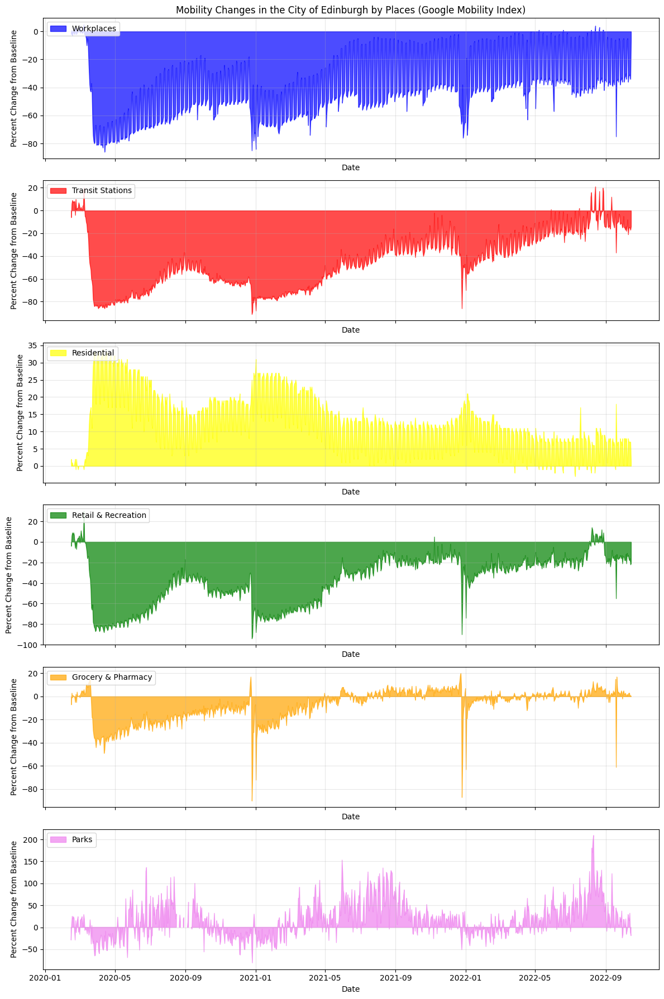

In [16]:
# Making visualization for the mobility data
'''
    The Google Mobility Reports aimed to provide insights into what changed in response to policies aimed at combating COVID-19. The reports charted movement trends over time by geography, 
    across different categories of places such as retail and recreation, groceries and pharmacies, parks, transit stations, workplaces, and residential.The data shows how visitors to 
    (or time spent in) categorized places change compared to our baseline days. A baseline day represents a normal value for that day of the week. The baseline day is the median value 
    from the 5‑week period Jan 3 – Feb 6, 2020.
        a. Workplace:  Mobility trends for places of work.
        b. Transit Station:  Mobility trends for places that are public transpo hubs, such as underground, bus and train stations.
        c. Residential: Mobility trends for places of residence.
        d. Retail & Recreation: Mobility trends for places such as restaurants, cafes, shopping centres, theme parks, museums, libraries and cinemas.
        e. Grocery & Pharmacy: Mobility trends for places such as supermarkets, food warehouses, farmers markets, specialty food shops and pharmacies.
        f. Parks:  Mobility trends for places like national parks, public beaches, marinas, dog parks, plazas and public gardens.

'''


# Making subplot, so we can shows the six graph based on the 6 different place that google mobility record the society mobility
fig, axs = plt.subplots(6, 1, figsize=(12,18), sharex=True)

# Creating the plot for Workplaces that indicate the mobility trend for going to workplaces, that can enrich the analysis the decline of traffic data when COVID-19 happens on 2020.  
axs[0].stackplot(edin_data["date"], edin_data["Workplaces"], labels=["Workplaces"], alpha=0.7, color="blue")
axs[0].set_title("Mobility Changes in the City of Edinburgh by Places (Google Mobility Index)")
axs[0].set_xlabel("Date")
axs[0].set_ylabel("Percent Change from Baseline")
axs[0].legend(loc="upper left")
axs[0].grid(alpha=0.3)

# Creating the plot for Transit Station (Public Transportation) that indicate the mobility trend for using public transport, that can enrich the analysis the decline of traffic data 
# when COVID-19 happens on 2020. 
axs[1].stackplot(edin_data["date"],edin_data["Transit Stations"], labels=["Transit Stations"], alpha=0.7, color="red")
axs[1].set_xlabel("Date")
axs[1].set_ylabel("Percent Change from Baseline")
axs[1].legend(loc="upper left")
axs[1].grid(alpha=0.3)

# Creating the plot for Residential
axs[2].stackplot(edin_data["date"], edin_data["Residential"], labels=["Residential"], alpha=0.7, color="yellow")
axs[2].set_xlabel("Date")
axs[2].set_ylabel("Percent Change from Baseline")
axs[2].legend(loc="upper left")
axs[2].grid(alpha=0.3)

# Creating the plot for Retail and Recreation that indicate the mobility trend for going to entertaintment places, such us cafe, museum, cinemas etc.
axs[3].stackplot(edin_data["date"], edin_data["Retail & Recreation"], labels=["Retail & Recreation"], alpha=0.7, color="green")
axs[3].set_xlabel("Date")
axs[3].set_ylabel("Percent Change from Baseline")
axs[3].legend(loc="upper left")
axs[3].grid(alpha=0.3)

# Creating the plot for Grocery & Pharmacy, that will enrich the analysis of supply chain of HGVs traffic data 
axs[4].stackplot(edin_data["date"], edin_data["Grocery & Pharmacy"], labels=["Grocery & Pharmacy"], alpha=0.7, color="orange")
axs[4].set_xlabel("Date")
axs[4].set_ylabel("Percent Change from Baseline")
axs[4].legend(loc="upper left")
axs[4].grid(alpha=0.3)

# Creating the plot for Parks that represents the mobility of people to doing outdoor activity including cycling ("pedal cycles traffic data")
axs[5].stackplot(edin_data["date"], edin_data["Parks"], labels=["Parks"], alpha=0.7, color="violet")
axs[5].set_xlabel("Date")
axs[5].set_ylabel("Percent Change from Baseline")
axs[5].legend(loc="upper left")
axs[5].grid(alpha=0.3)

plt.tight_layout()
plt.show()


#### Insight from the graph:
🚩 This graph provides an overview of mobility changes in the City of Edinburgh across different place types from 2020 to 2022 based on `Google Mobility Data`, as a percentage change from baseline levels. Below is the analysis for each category:

1. `Workplaces (Blue)`: 
   - There is a significant drop in workplace mobility at the start of 2020, corresponding to the onset of COVID-19 and lockdown measures. 
   - The levels remained well below baseline throughout the period, reflecting prolonged work-from-home policies and changing work patterns.
   - Some recovery is evident in late 2021 and 2022, though not to pre-pandemic levels.

2. `Transit Stations (Red)`:
   - Transit station mobility shows a dramatic decline in early 2020, consistent with reduced public transport usage during lockdowns.
   - Recovery is gradual but uneven, indicating continued hesitancy or reduced reliance on public transport post-pandemic.

3. `Residential (Yellow)`:
   - Residential mobility increased sharply during lockdowns in 2020, reflecting people staying at home.
   - While it gradually declined over time, it remains slightly above baseline, suggesting sustained changes in home-based activities, such as remote work or schooling.

The poin (1), (2), and (3) `support the evidence` from previous section that there is `sharp decline` in traffic data in overall type of vehicles. This because of the mobility of the society is limited and restricted due to the government policy such as social restriction or lockdown. The people works from home, so the workplace mobility and mobility to public transport was declined on 2020 during pandemic. Menawile, because people just get locked on home, the mobility of residential place was increased sharply during pandemic. These are the evidence that explain more why the traffic data was dramatically decline, but experienced recovery after the pandemic was over.

4. `Retail & Recreation (Green)`:
   - This category experienced a sharp drop during lockdowns, reflecting closures of non-essential businesses and restricted social activities.
   - Recovery began with the easing of restrictions but remained below baseline, suggesting a slower return to pre-pandemic levels.

5. `Grocery & Pharmacy (Orange)`:
   - Mobility in grocery and pharmacy locations dropped early in the pandemic but recovered more quickly than other sectors, reflecting the essential nature of these services.
   - The overall trend shows stability, returning close to baseline levels by late 2021.

This poin support for `supply chain of HGVs traffic data`, which was slighly decline during COVID-19, but still persistent due to people needs for logistics and other stuff to fullfill their daily needs. 

6. `Parks (Purple)`:
   - Mobility to parks increased significantly during periods of lockdown, as people sought outdoor spaces for exercise and leisure.
   - Peaks align with warmer months and periods of stricter indoor restrictions, demonstrating the reliance on outdoor spaces during the pandemic.

This point support `"pedal cycles"` traffic data that suprisingly increased during COVID-19 because of outdoor activity and move such as `cycling`, that are considered not to have much contact with other people, as well as efforts to maintain physical and mental health during the pandemic. This turned out to be one of the cultures that emerged during the COVID-19 pandemic, namely the golden age of cycling.

### Key point:
The data shows `clear behavioral changes due to the pandemic`, with a shift toward staying at home, reduced public transport usage, and increased reliance on outdoor spaces. While some sectors, such as grocery and pharmacy, have largely returned to baseline, others, like workplaces and transit stations, remain below pre-pandemic levels, reflecting lasting changes in mobility patterns. `This mobility strongly related to the density of traffic data` that we explain before on the previous section. 

---
# Fun Fact: Timelapse of Traffic Data Density in Scotland 🚩

Inspired by Ploty `Bubble Map with Animation` [see:](https://plotly.com/python/bubble-maps/)


In [17]:
import geopandas as gpd
import plotly.express as px

## To identify the traffic data density by region over time to time `Bubble Map with animation` based on Plotly documentation 
'''
    Input:
    The input is a dataset named `traffic_data_by_region`, containing information about longitude, latitude, total motor vehicles (`all_motor_vehicles`), time of day (`hour`), year, 
    and regional names (`local_authority_name`). The data is filtered to include only records from the year 2000 onward and sorted by year for temporal analysis.

    Process:
    The filtered data is transformed into a GeoDataFrame using GeoPandas. Longitude and latitude are converted into geometry points.
    Bubble size and color represent vehicle density, with animations based on the `year`.

    Output:
    The output is an interactive map visualizing traffic density across regions in Scotland. Larger and darker bubbles indicate higher vehicle density, while an animation shows changes over time. 
    Users can explore peak traffic areas and trends dynamically, providing insights into regional traffic patterns from 2000 onwards.

'''
data_reg = read_data('traffic_data_by_region')


data_reg4 = data_reg[data_reg["year"] >= 2000]
data_reg4 = data_reg4.sort_values(by="year")
geometry4 = gpd.points_from_xy(data_reg4["longitude"], data_reg4["latitude"])
geo_df4  = gpd.GeoDataFrame(data_reg4[["all_motor_vehicles", "hour", "year", "local_authority_name"]], geometry=geometry4)
geo_df4.crs = 'epsg:4326'

fig = px.scatter_geo(geo_df4, lat=geo_df4.geometry.y, lon=geo_df4.geometry.x, color=geo_df4.all_motor_vehicles, size=geo_df4.all_motor_vehicles,
                            animation_frame=geo_df4.year, projection="mercator", hover_name=geo_df4.local_authority_name)

fig.update_layout(width = 1200, height = 800, title=dict(text="Total Traffic Data by Region in Scotland, 2000-2023"))
fig.show()

C:\Users\loren\AppData\Local\Temp\ipykernel_28308\1339391667.py:13: DtypeWarning:

Columns (12,13) have mixed types. Specify dtype option on import or set low_memory=False.



### Fun Fact:
- In general, traffic data in Scotland has shown an upward trend over time, with an increase in vehicle density every year from 2000 to 2019. However, during the COVID-19 pandemic, a significant decline was observed, with traffic volumes dropping sharply due to movement restrictions and reduced commuting activities.

- When analyzed regionally, the highest traffic densities were recorded in major cities such as Glasgow and Edinburgh. These urban centers consistently experienced heavy vehicle traffic, reflecting their role as economic and administrative hubs. The sharp decline during the pandemic underscores the impact of reduced urban mobility, particularly in densely populated areas, highlighting the significant influence of external events on traffic patterns in Scotland.

---

---
---
# 🚩Section 2 
# Busiest Roads in Scotland
---


🚩**Overview:**

This section of our analysis aims to identify the most frequented roads, on average, during the 24 years between 2000 and 2023.
As a measure for classifying roads, the average count of observations was taken as reference, at any counting point for each road. We will see later in more detail how the data has been treated.
After coming to a conclusion regarding the busiest roads of Scotland, this section focuses on the analysis of how roads are distributed where there is insufficient information about them.

---

In [18]:
import pandas as pd
import os
import numpy as np
import matplotlib.pyplot as plt
import folium
from folium import plugins
import geopandas as gpd

First we download the file "dft_rawcount_region_id_3.csv" of interest for our analysis and import it as dataset. If the file is already present in our working environment, we just import it.

In [19]:
def read_data( filename ):
    '''
    Download or read the file, depending if it is already present in our work environment.

    Input: -filename (str) : name of the file of interest.
    
    Output: -traffic_data : dataset cointaing data in filename.
    '''

    if os.path.exists( filename ):
        
        traffic_data = pd.read_csv(filename, dtype={12: 'str', 13: 'str'}) #Setting dtype after error

    else:

        print('Downloading the file...')
        
        url = f'https://storage.googleapis.com/dft-statistics/road-traffic/downloads/rawcount/region_id/dft_rawcount_region_id_3.csv'
        traffic_data = pd.read_csv(url)

        #Save the file
        traffic_data.to_csv(filename)
    
    return traffic_data

## Methodology and Cleaning The Data

Initial cleaning of the dataset:

In [20]:
def initial_clean(data_traffic):
    
    """
    Performs initial cleaning for the dataset.
    
    Input : -data_traffic (dataset) : dataset to perform cleaning on.
    
    Output: -data_traffic_no (dataset) : new dataset after cleaning is performed. 
    """
    
    #Check if there is an unnamed column, if there is delete it:
    if 'Unnamed: 0' in data_traffic.columns:

        #Remove
        data_traffic = data_traffic.drop('Unnamed: 0', axis=1)

    #basic information on the dataset:

    #Counting number of rows of the dataset
    number_rows = data_traffic.shape[0]
    number_col = data_traffic.shape[1]

    print( f'\nTotal number of rows in the dataset : { number_rows }' )
    print( f'\nTotal number of columns is: { number_col }' )

    #Counting number of rows with NAs values inside
    rows_with_na = number_rows - len( data_traffic.dropna() )

    print( f'\nTotal number of rows with NAs data: { rows_with_na }' )
    print( f'\nProportion of rows with NAs is: {round( rows_with_na/number_rows , 2 )}' )

    #Investigate where the most of NAs values are
    na_per_column = data_traffic.isna().sum()

    print( f'\nWhere NAs come from?\n{ na_per_column }' )

    #Remove all the columns (axis = 1) with NAs
    data_traffic_no = data_traffic.dropna( axis=1 )

    print(f'\nAfter cleaning number of NAs is:{ data_traffic_no.isna().sum().sum() }')

    #Notice that 'count_date' column is not in date format, change it in case we need it later
    data_traffic_no.loc[:, 'count_date'] = pd.to_datetime( data_traffic_no['count_date'] )
    
    #Check number of NAs that might be be created in the process
    n_na_date = data_traffic_no['count_date'].isna().sum()
    print( f'\nNumber of NA after the type change of column \'count_date\' : { n_na_date }' )

    return( data_traffic_no )

#Actually download file and import datase
data_start = read_data( 'traffic_scotland' )

#Perform data cleaning
data_clean0 = initial_clean( data_start )

C:\Users\loren\AppData\Local\Temp\ipykernel_28308\2738345162.py:19: DtypeWarning:

Columns (11,12) have mixed types. Specify dtype option on import or set low_memory=False.




Total number of rows in the dataset : 306096

Total number of columns is: 32

Total number of rows with NAs data: 164280

Proportion of rows with NAs is: 0.54

Where NAs come from?
count_point_id                       0
direction_of_travel                  0
year                                 0
count_date                           0
hour                                 0
region_id                            0
region_name                          0
local_authority_id                   0
local_authority_name                 0
road_name                            0
road_type                            0
start_junction_road_name        164280
end_junction_road_name          164280
easting                              0
northing                             0
latitude                             0
longitude                            0
link_length_km                  164028
link_length_miles               164028
pedal_cycles                         0
two_wheeled_motor_vehicles           0

In the data cleaning function built above, ***some basic analysis of our whole dataset*** has been performed. 

- At first a column named 'Unnamed: 0' has been removed. It had been noticed how, sometimes, during the importation of the 
 dataset, a column indicating the number of each row had been created, in order to avoid wasting space the decision was to eliminate it.

- The dimension of the dataset were analysed. `The dataset it is huge with 306096 rows and 32 columns.`

- First check to see how many NAs values are present in the dataset. Quite a big proportion of rows (54%) presented NAs 
 values. Important to understand where these come from, in order to do that visualise how many NAs are present in each column. It is clear that the NAs are concentrated in the columns: 'start_junction_road_name', 'end_junction_road_name','end_junction_road_name' and 'link_length_miles'. Those columns do not seem relevant for the type of analysis that is going to be performed, so they are removed. After this is done the number of NAs is computed again and is confirmed to be zero.

- As last step, it had been noticed how the column 'count_date' is not in the proper format. Then the format of  
 'count_date' is updated as a proper one, in case later it will be needed to perform operation on dates.

After cleaning is done, the actual data transformation can begin, in order to perform the analysis.

The first goal of the process is `to visualise the most busy roads in Scotland`, on average for each count, over the data from the 24 years of the dataset. 

This process is not immediate and will be performed using multiple functions. 
    - First, averages for each observation will be calculated for each road, initially aggregating the data on each year. 
    - Then, for the roads it will be considered appropriate, an interpolation step will be performed. 
    - Finally, the results can be viewed.

The mean will be calculated over the observations for ***'all_motor_vehicles',*** but in order to keep the code as general as possible, the functions are built in order to easily allow also other types of choice.

🔍 Let’s proceed with the first function:

In [21]:
def years_means (datas, variable ):

    """
    Not considering type 'C' and 'U' roads.
    Building dataset with only columns relevant to the analysis.
    Compute the mean in each year, for the column named variable, for each street in the dataset.

    input: -datas : dataset to work on.
           -variable: name of the column to perform the mean on.

    output: -yearly_data_road : dataset cointaing the columns 'road_name', 'year' and the mean of variable for each year and road.
    """

    #Not considering 'C' and 'U' roads
    datas = datas[~datas['road_name'].str.startswith(('C', 'U'))]
    
    #Columns that will be needed for first round of analysis
    rel_cols = ['road_name', 'year', variable]

    #Considering only columns relevant to the analysis
    datas = datas[ rel_cols ]

    #For each road and for each year compute the mean of total traffic per day on each year (keeping a dataset structure)
    yearly_data_road = (datas.groupby(['road_name', 'year'])[variable].mean()
                        .reset_index().rename(columns={variable: 'mean observation'})) #rename column for clarity
    
    return yearly_data_road

#Compute means for all_motor_vehicles  
yearly_data_all_vehic = years_means( data_clean0 , 'all_motor_vehicles' )


The function year_means(), applied as above, performs the basic initial computation of the mean for an observation of the column 'all_motor_vehicles'. It returns a dataset containing, for each road the mean for an observation over one year time, with the data available.

Note: it is not sure that for each road there is data for every year from 2000 to 2023. In order to monitor the situation we go on with some new functions.

In [22]:

def prep_for_interpolation(datas, tresh = 60):
    """
    Create a new dataset with every year from 2000 to 2023 for each road, initially fill it with NAs.
    Then merge the new dataset with datas (dataset cointaing values of the mean of the observation for each year).
    Check for streets with NAs, in terms of percentage over years, greater than a treshold. 
    Return two dataset: one with streets that have less NAs , in percentange, than the treshold and one with streets that
    have more NAs.

    Input: -datas: dataset with columns 'road_name', 'year' and 'mean observation'.
           -tresh: (int), treshold for percentage of NAs (default is 60).

    Output: -data_for_interpolation: dataset with data for streets with lower NAs than the treshold.
            -excluded_data: dataset with data for streets with higher NAs than the treshold.
    """
    #Eeach year in the dataset
    all_years = range(datas['year'].min(), datas['year'].max() + 1)

    #Each road_name in the dataset
    road_names = datas['road_name'].unique()

    #create a new dataset, with each row filled with each street and each year

    new_years_mean_road = pd.DataFrame([(road, year) for road in road_names for year in all_years],
                            columns=['road_name', 'year'])

    #fill the new dataset with data that we have (now we have NAs for years we do not have data)
    new_years_mean_road = new_years_mean_road.merge(datas,how='left')

    #count how many NAs (in percentage) for each street:

    #numbers of observations expected for each street
    n = len(all_years) 

    #number of actual observations for each street
    missing_counts_per_street = new_years_mean_road['mean observation'].isna().groupby(new_years_mean_road['road_name']).sum()

    #compute percentage for each street
    missing_percentage = (missing_counts_per_street / n) * 100

    #streets with more than 60% of missing data
    streets_with_missing_data = missing_percentage[missing_percentage > tresh]

    #how many are they? (in percentage)
    num_streets_with_missing_data = len(streets_with_missing_data)
    num_total_roads = len(road_names)
    percentange_street_over_tresh_na = num_streets_with_missing_data / num_total_roads

    print(f"Percentange of streets with more than {tresh}% of missing data: {percentange_street_over_tresh_na}")
    #name of streets to exclude
    streets_to_exclude = streets_with_missing_data.index 

    #set of data for interpolation
    data_for_interpolation = new_years_mean_road[~new_years_mean_road['road_name'].isin(streets_to_exclude)]

    #create a dataset with the exluded data for later analysis
    excluded_data = new_years_mean_road[new_years_mean_road['road_name'].isin(streets_to_exclude)]

    return data_for_interpolation,excluded_data

interp_all_vehic, exclud_all_vehic = prep_for_interpolation(yearly_data_all_vehic)



Percentange of streets with more than 60% of missing data: 0.5403225806451613


As explained in the docstring of the function above, initially a new dataset is created. The new dataset initially contains two columns: 'road_name' and 'years'. For each road contained in the "old" dataset, we build a new dataset with a row for each year. 
After the new dataset is merged with the old one, in this way in the new dataset the column 'mean observation' is associated with each road and year. In particular, for the years we do not have data available we now have NAs.
This structure of the dataset is useful for application, applied later.

⚠️ Before of applying interpolation we need to check how many data are actually available for each street. In order to do so, for each street we compute the percentage of years where there are NAs in the column 'mean observation'. The streets are then divided into two dataset, based on if the percentage of NAs is higher than a treshold (default value 60% above).
The two dataset are then returned.

`MAIN POINT:` is that it does not make sense to interpolate on streets we do not have enough data for, because the estimate would not be reliable.

With the treshold set at 60%, it is computed that around 54% of the street in the initial dataset are not considered for interpolation (quite an high value! This will be analysed further later).



Now, finally, perform interpolation on the data that made it here:

In [23]:
def perform_interp(datas):
    """
    Perform interpolation on the dataset 'datas', assuming is a dataset ready for interpolation, with columns:
    'year','road_name', 'mean observation'.

    input:  -datas: dataset, to perform interpolation on.

    output: -datas: dataset, after interpolation has been performed.
    """
    
    #Interpolating data for each road separately

    # how to perform interpolation:
    # URL: https://pandas.pydata.org/docs/user_guide/missing_data.html#interpolation
    # Accessed on 27 Nov 2024.

    #Iterating on each road in the dataset
    for road_name in datas['road_name'].unique():

        #Get data about the current road
        road = datas[datas['road_name'] == road_name]

        #Make sure to sort data by year
        road = road.sort_values('year')

        #PErform interpolation
        road['mean observation'] = road['mean observation'].interpolate(method='linear')

        #Uptade original dataset
        datas.loc[road.index, 'mean observation'] = road['mean observation']

    return datas

def compute_mean(datas):
    """
    After interpolation compute mean on column 'mean observation'.Obtaing new dataset with only one mean value
    for each street.

    input: -datas: interpolated dataset (assuming has columns 'road_name' and 'mean_observation').

    output: -average_per_road: new dataset with only one value for 'mean observation' for each street.
    """
    #Compute the mean for each street on interpolated datas
    average_per_road = datas.groupby('road_name')['mean observation'].mean().reset_index()
    
    return average_per_road

data_interpolated_all_vehic = perform_interp(interp_all_vehic)
mean_interp_all_vehic = compute_mean(data_interpolated_all_vehic)


## 2.1 The 10 Most Busy Roads 

✅ After interpolation is performed, it is possible to compute the average observation for each street. Finally is then possible to extract *the 10 most busy roads* and plot a barplot to visualise results:

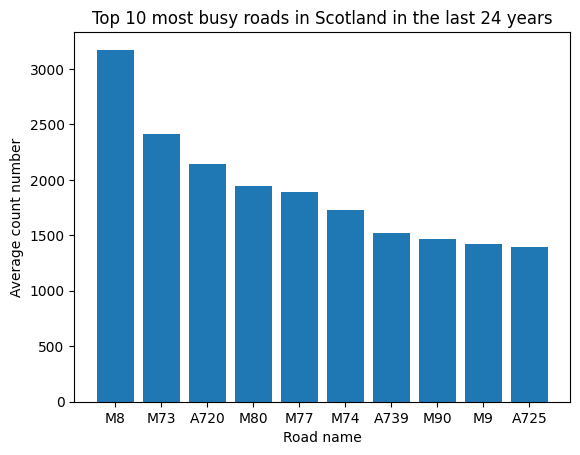

In [24]:
def top_10_roads(datas):

    """
    Create dataset of top 10 most busy roads ( based on mean observation  ). Works on already interpolated datasets.

    input:  -datas: dataset (assumed to have columns: 'road_name', 'mean_observation')

    output: -top_10_roads: data contained in the dataset 'datas' about the 10 rows with highest value for 'mean
                           observation' 
    """

    #Extract top 10 busy rooads
    top_10_roads = datas.sort_values(by='mean observation', ascending=False).head(10)

    #Barplot to visualise data
    fig, ax = plt.subplots() 
    ax.bar(top_10_roads['road_name'], top_10_roads['mean observation']) 
    ax.set_title('Top 10 most busy roads in Scotland in the last 24 years')
    ax.set_xlabel('Road name')  
    ax.set_ylabel('Average count number')
    plt.show()

    return top_10_roads

top_10_all_vehic = top_10_roads(mean_interp_all_vehic)


The barplot above shows ***the 10 busiest roads in Scotland over the past 24 years,*** based on the average number of traffic observations. Some observation can be made:

🔺 `Majority of Motorways (M__):` as expected, the majority of the roads in the top 10 are motorways. This reflects the 
 critical role motorways play in handling large-scale traffic and connecting major urban centers.

🔺 `Presence of Major Roads (A__):` among the top 10 roads, three are classified as major roads (A720, A739, and A725). Their 
 inclusion in the list highlights that these routes, while not motorways, still play a significant role in regional transportation and traffic flow.

🔺 `Absence of Minor Roads (B__):` no minor roads (classified as B roads) are present in the list, indicating that these roads 
 generally experience significantly lower traffic volumes and are likely used mainly for local travel.

🔺 `M8 at the Top:` The M8 is the busiest road, with an average count exceeding 3,000 observations. As Wikipedia notes ((https://en.wikipedia.org/wiki/M8_motorway_(Scotland))): 
 "The M8 is the busiest motorway in Scotland. It connects the country's two largest cities, Glasgow and Edinburgh, and serves other large communities"
 This explains why this road is at first place in the analysis.

🔺 `A720 in third Place:` since the majority of busiest roads are motorways, it could seem weird that a major road fits in the podium. But as Wikipedia states (https://en.wikipedia.org/wiki/Edinburgh_City_Bypass): 
"The Edinburgh City Bypass, designated as A720, is one of the most important trunk roads in Scotland." 
Also, "This road plays a crucial role in facilitating traffic around Edinburgh, alleviating congestion in the city center and acting as a major arterial route for local and regional traffic."

Driven by curiosity, it's possible to visualise the trend, year by year, for each street in the top 10:

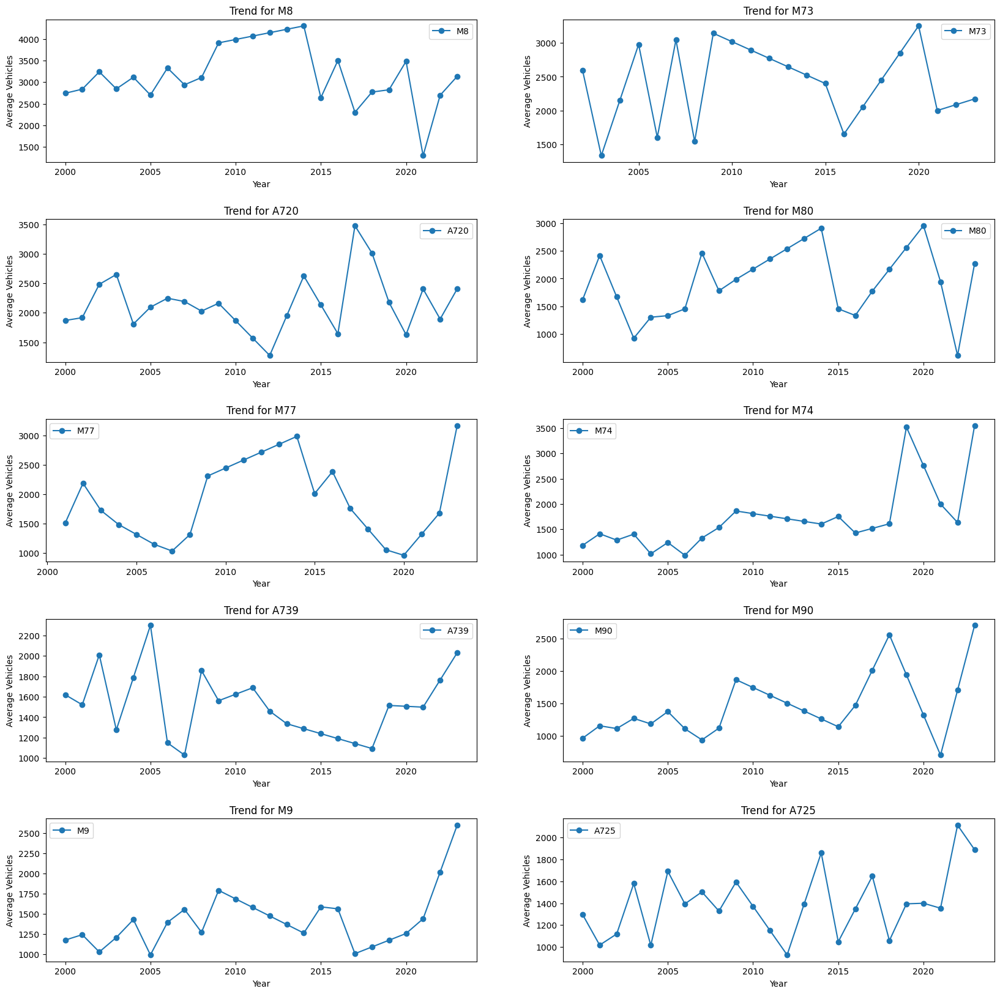

In [25]:
def plot_top_10_trends(data, top_10_roads):
    """
    Line plot for each of the top 10 busiest roads in Scotland. In order to show the trend of the mean of observation count
    over the years in each of the road.

    Inputs: -data: dataset assumed of the structure: 'road_name', 'year and 'mean observation' 
            -top_10_roads: dataset containg top 10 busiest roads
    """

    #Extract name anda data for each one for each road in the top10
    top_10_names = top_10_roads[ 'road_name' ].unique()

    data_top10= data[ data[ 'road_name' ].isin(top_10_names) ]

    #Make a subplot for each road
    fig, ax = plt.subplots( 5, 2, figsize=( 20, 20 ) )  

    #Initialise objects to plot
    i=0
    j=0

    #Looping on each road
    for road_name in ( top_10_names ):
        
        #Extract data for each road
        road_data = data_top10[ data_top10[ 'road_name' ] == road_name ]

        #Plot for each road
        ax[i][j].plot( road_data[ 'year' ], road_data[ 'mean observation' ], marker = 'o', label=road_name )
        ax[i][j].set_title( f'Trend for {road_name}' )
        ax[i][j].set_xlabel( 'Year' )
        ax[i][j].set_ylabel( 'Average Vehicles' )
        ax[i][j].legend()

        #Update elements for plotting
        j += 1

        #In case finish space on actual row, move to the next
        if j == 2 :
            i += 1
            j = 0

    #Show plots with enough space between each other  
    plt.subplots_adjust(hspace=0.4) 
    plt.show()

plot_top_10_trends(data_interpolated_all_vehic, top_10_all_vehic)

Some `trends can be recognised in the plots above:`

🔺`Overall growth:` roads like M8, M73, and A720 demonstrate a general upward trend in average vehicle counts over the years. 
 This reflects their increasing importance and usage.

🔺`Fluctuations:` all roads show significant year-to-year fluctuations. These could be because of various factors, including roadworks, changes in measurement practices, or seasonal variations in traffic.

🔺`Impact of the COVID-19 Pandemic:` as analysed in section 1, a pronounced dip is visible across all roads around 2020, which corresponds to the COVID-19 pandemic. This reflects reduced traffic due to lockdowns and restrictions. However, in the years after 2020, it seems that the volumes of traffic are back to pre-pandemic levels.


`Road-Specific Observations:`

- M8: shows consistent growth over the years, showing its vital role in connecting Glasgow and Edinburgh.

- A720: notable for  periodic fluctuations but a general increase over time, underlining its role as a key bypass for Edinburgh.
---

---
## 2.1 `Second Part of the Analysis:` Focus on the excluded data?

📢 In this subsection, the point that we are going to analyze are:
- Are roads in the excluded dataset roads less busy than the one that have made it trough the interpolation process?
- What type of roads are in the excluded dataset? 
- How are they distributed over the country?

All these questions will be answered in this section.

---



As we have arrived to the visualisation of the 10 most busy roads in Scotland, it's time to remember about the part of dataset that was excluded for the last part of the analysis because of the treshold set, during the preparation for the interpolation process.

It is interesting to see if the roads contained in the excluded datas could compete, in terms of traffic volume, with those that have been already considered.

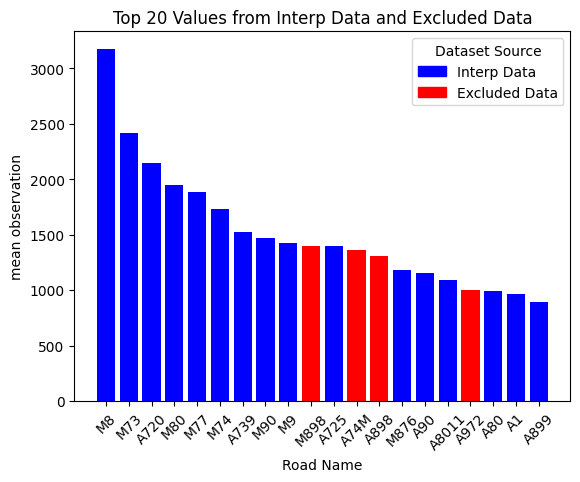

In [26]:

def get_values_from_exclud_data(excluded_data):
    
    """
    Compute mean for each road in the dataset excluded data. Because of how it is built, from last
    computation our column of interest is the last of the dataset.

    Input: -excluded_data: dataset assumed having (numerical) column of interest as last one and 
                           column 'road_name'
    
    Output: -street_means: dataset with mean for each road of the column of interest. 


    note: for us the column of interest will be 'mean observation'
    """
    
    #Because of how excluded data is build datas we are interested in are in the last column
    last_column = excluded_data.columns[ -1 ]

    #Compoute mean for each street
    street_means = excluded_data.groupby( 'road_name' )[ last_column ].mean().reset_index()

    return street_means

def bar_exlc_plus_interp( interp_data, excluded_data, top_n = 20 ):

    """
    Plots a bar blot visualising the highest element of two combined datasets (assuming they have
    the same structure).
    In the plot the bars have different colours to show where the data came from.
    
    Input:  -interp_data: one of the dataset to use for the bar plot
            -excluded_data: other dataset to use
            -top_n: number of elements to show on the plot (default is 20)
    """

    #For how it is built column of interest is in the last position of excluded data
    column_name = excluded_data.columns[-1]

    #New columns to identify where the datas come from
    interp_data['source'] = 'Interp Data'
    excluded_data['source'] = 'Excluded Data'
    
    #Put the two datasets together
    combined_data = pd.concat([interp_data, excluded_data])
    
    #Sort the dataset by the column of interes and select the top_n
    top_data = combined_data.sort_values( by=column_name , ascending=False).head( top_n )  
    
    #Plot barplot, color by where the datas come from 

    # ideas of how to plot:
    # URL: https://matplotlib.org/stable/gallery/lines_bars_and_markers/bar_colors.html#sphx-glr-gallery-lines-bars-and-markers-bar-colors-py
    # Accessed on 27 Nov 2024.
    
    #Getting type of road for each street in the top20
    bar_labels = [type for type in top_data['source']]

    #Initialising list for colours in the plot
    colours = []

    #blue for interpolated data, red for excluded
    for type in bar_labels:
        if type == 'Interp Data':
            colours.append('Blue')
        else:
            colours.append('Red')

    #bar plot
    fig, ax = plt.subplots()
    ax.bar(top_data['road_name'], top_data[column_name], color = colours)
    ax.set_xlabel('Road Name')
    ax.set_ylabel(column_name)
    ax.set_title(f'Top {top_n} Values from Interp Data and Excluded Data')
    plt.xticks(rotation=45) 

    #names for the legend
    legend_labels = ['Interp Data', 'Excluded Data']
    
    #labels for the legend
    handles = [plt.Rectangle((0, 0), 1, 1, color='blue'), 
               plt.Rectangle((0, 0), 1, 1, color='red')]
    
    ax.legend(handles, legend_labels, title='Dataset Source')
   
    
    plt.show()

#Without interpolating get the mean from each road in the excluded dataset
means_all_vehic_excl = get_values_from_exclud_data(exclud_all_vehic)

#Plot a bar to show where the busiest roads are stored
bar_exlc_plus_interp(mean_interp_all_vehic,means_all_vehic_excl)




📝 This visualization shows ***the relationship between the interpolated and excluded datasets*** in terms of identifying the busiest roads in Scotland.

- The blue bars represent roads from the interpolated dataset, which includes roads with data available for more than 60% of the years analyzed.

- The red bars represent roads from the excluded dataset, which had data for `less than 60% of the years.`

- The idea is to find out if the most frequented roads have been properly monitored between 2020 and 2023 (and so to verify if the previous choice made in the developing of the previous analysis is justified). This seems to be case since 16 out of the 20 must busy roads are contained in the interpolated dataset, this means that we had enough datas about that roads.

- The red bars show that some roads from the excluded dataset still have relatively high average traffic counts. However, their exclusion was likely necessary due to insufficient data for accurate analysis.

- The presence of relatively busy roads in the excluded dataset suggests there may be important routes with data limitations that could benefit from a better monitoring system.

- The decision to focus on roads with more consistent data (interpolated dataset) in the previous analysis appears to have been effective in maintaining a quite complet view of Scotland’s busiest roads.

📢 `NOTE:`

To get result regarding the roads in the excluded dataset, the simple mean of the available data has been taken. Of course this is not as informative as the interpolation process, but it gives an idea of the volume of traffic.



Now, move on to analysing how excluding data are distributed between the different types of road:

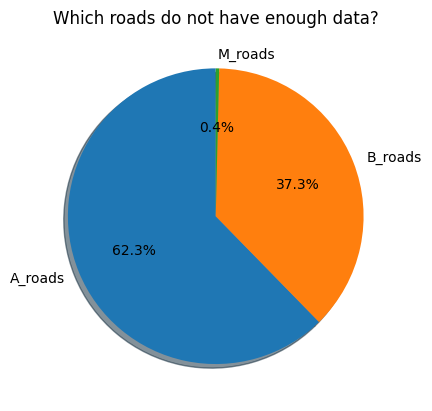

In [27]:
#analyse data excluded from interpolation

def analyse_excluded(excluded_data):
    """
    Figure out distribution of type of roads in a dataset. Pie plot to show result.

    Input: -excluded_data : dataset, assumed with column 'road_name'
    """

    #Number of total roads in the excluded dataset
    total_roads = len(excluded_data['road_name'].unique())
    
    #Initialise counter for missing roads of each type
    num_missing_roads = []

    #Initiliase for labels
    label_roads = []

    #Initialise for percetanges
    percentages = []

    #Extract road names for analysis
    unique_roads = excluded_data['road_name'].unique()

    # ideas of how to plot:
    # URL: #https://matplotlib.org/stable/gallery/pie_and_polar_charts/pie_features.html#sphx-glr-gallery-pie-and-polar-charts-pie-features-py
    # Accessed on 25 Nov 2024.

    for letter in ['A','B','M']:

        #Store label for later graph
        label_roads.append(f'{letter}_roads')

        #Compute how many roads for each type:
        n = sum(road.startswith(letter) for road in unique_roads)
        
        #Store in counter
        num_missing_roads.append(n)

        #Store percentages
        percentages.append(n/total_roads * 100)
    
    #Pie plot 
    fig, ax = plt.subplots()

    ax.pie(percentages, labels=label_roads , autopct='%1.1f%%',shadow=True, startangle=90)

    ax.set_title('Which roads do not have enough data?')

    plt.show()
    

#Apply function to excluded data from all_vehicl analysis
analyse_excluded(exclud_all_vehic)

The pie plot is basic, but gives some important insigths:

✅ Motorways (M_roads) make up `a very small fraction (0.4%)` of the excluded dataset.
This indicates that almost all motorways are well-monitored and have sufficient data for reliable analysis, reflecting their importance in Scotland's road network.

✅ Major roads (A_roads) represent `the majority (62.3%) of the roads` with insufficient data are main roads.
This suggests that a significant number of these roads, while important, may not have been consistently monitored over the years.

✅ Minor roads (B_roads) account for `37.3% of the excluded dataset.`
These roads are likely monitored less consistently due to their local role in traffic network.

Efforts to improve data collection on A_roads in particular could be important for a better understanding of the traffic network in Scotland, as seen above, major road can take some important volumes of traffic.

Now, we focus on looking where the road of the excluded dataset are distributed over Scotland's terrritory. In order to visualise that all the counting points registred for each street are extracted and visualised using folium (heat map).


In [28]:
from folium import plugins
import geopandas as gpd

def visualise_exclud_roads(excluded_data, datas):
    """
    Visualise the distribution, through an heat map, of the counting points from the roads contained in excluded_data,
    making sure unique combinations of latitude and longitude are used.

    Input: excluded_data: dataset of the excluded_road (assumed to contain colum 'road_name')
           datas: original (cleaned) dataset, assumed to contain the columns : 'road_name', 'latitude', 'longitude'.
     """
    #Extract name of the streets to visualise data about
    unique_excl_roads = excluded_data['road_name'].unique()

    #Get back to original set of data for those streets
    exclud_data_complete = datas[datas['road_name'].isin(unique_excl_roads)]

    #Extract latitude and longitude for plotting map
    data_for_map = exclud_data_complete[[ 'latitude', 'longitude']]

    # ideas of how to plot:
    #https://geopandas.org/en/stable/gallery/plotting_with_folium.html
    # Accessed on 25 Nov 2024.

    #Consider only one each combination of latitude and longitude
    data_for_map = data_for_map.drop_duplicates()

    #Compute center of the geographic centre for the data available (used for nice plotting)
    cent_lat = data_for_map[ 'latitude' ].mean()
    cent_lon = data_for_map[ 'longitude' ].mean()

    #Build map
    hmap = folium.Map( location = [cent_lat, cent_lon ], tiles = "OpenStreetMap", zoom_start = 7 ) 

    # Build geometry for the points to visualise
    geometry1 = gpd.points_from_xy( data_for_map[ 'longitude' ], data_for_map[ 'latitude' ] )

    #Set data for the map
    heat_data = [ [ point.xy[1][0], point.xy[0][0] ] for point in geometry1 ]

    #Add heat map with our geometry to the map object created before
    plugins.HeatMap( heat_data ).add_to( hmap )

    return hmap


#Visualise distribution of missing data from excluded dataset 
map_result = visualise_exclud_roads(exclud_all_vehic, data_clean0)
map_result


📊 This `heatmap` illustrates the spatial distribution of missing traffic data across Scotland:

- The regions with the highest concentration of missing data **("red" areas)** correspond to the largest cities: area of `Edinburgh and Glasgow.`

- This pattern may reflect the higher number of roads in urban areas, increasing the probability of some roads having insufficient data.

- On the other hand missing data is also observed in less populated regions, such as `the far north or southern areas of country.` These regions likely have fewer roads, but their inclusion in the heatmap demonstrates that monitoring gaps are not exclusive to urban settings.

- The `missing data appears to be relatively evenly spread across the country.` There are no extensive areas completely lacking data.


To improve interpretation, `normalizing the missing data` based on the density of roads in each region would provide a clearer understanding of how well the road network in each area is monitored. This would allow for direct comparisons between `urban and rural areas.`



---

---
---
# 🚩Section 3 
# The Anglo-Scottish Border: An analysis of Heavy Goods Vehicles traffic from 2000-2023
---

**Outline:**
1. Determination of DfT count points within 50km of the Anglo-Scottish Border
2. Observed traffic of heavy goods vehicles at these count points by hour, from 2000-2023 
3. Selecting and visualizing the checkpoints 
4. Estimating and Visualizing Monthly and Yearly Traffic Volume from 2000-2023
5. A Conclusion

🚩**Overview:**

The economy of Scotland is intimately intertwined with that of the rest of the United Kingdom. In fact, according to the Scottish government, England, Wales, and Northern Ireland combined buy more than 60% of Scottish goods. While the previous two sections focused on understanding the impact of the Covid pandemic as well as the geometry of Scotland's internal mobility and traffic, in this final section we attempt to investigate the heavy goods traffic between Scotland and England across the last 24 years by looking at the subsection of Scottish road traffic data recorded at count points close to the border, finally trying to establish a connection between this traffic and the broader financial phenomena.

--- 

## 3.1 Determining the count points within 50km of the Anglo-Scottish Border 

✅ Determine the count points within 50km of the Anglo-Scottsh border, by computing distances

--- 

### Methodology:
- First, from the initial .csv file, we select a dataframe formed from unique copies of the coordinates of the count points.

- Next, we compute the distance between each count point to the border by computing the Euclidean distance between the point and a line approximating the border. This Euclidean distance will be similar to the geodesic (real) distance, since we are only computing relatively small distances between different locations in Scotland.

- After computing these distances, we can select the closest count points to the border (<50km away from it), in order to determine the locations of the desired count points.

--- 

First, we make sure to install all the required libraries:

In [29]:
pip install -r requirements.txt

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.0 -> 25.0.1
[notice] To update, run: C:\Users\loren\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


In [30]:
import pandas as pd
import numpy as np 

import matplotlib.pyplot as plt
import math

import geopandas as gpd
import folium
from shapely.geometry import Point

import os

In [31]:
# Read the data again, using the previously defined function
data_traffic_raw = read_data('traffic_scotland')

⚠️ After reading the data again, we perform the same cleaning that was performed in the second section, as once again the columns 'start_junction_road_name', 'end_junction_road_name','end_junction_road_name' and 'link_length_miles' are not used in the analysis performed herein. Moreover, for the second subsection of this analysis, we also need to process 'count_date' in the same way.

In [32]:
# Clean up the data, using the data cleaning function defined in the 2nd part of the project
data_traffic = initial_clean(data_traffic_raw)


Total number of rows in the dataset : 306096

Total number of columns is: 32

Total number of rows with NAs data: 164280

Proportion of rows with NAs is: 0.54

Where NAs come from?
count_point_id                       0
direction_of_travel                  0
year                                 0
count_date                           0
hour                                 0
region_id                            0
region_name                          0
local_authority_id                   0
local_authority_name                 0
road_name                            0
road_type                            0
start_junction_road_name        164280
end_junction_road_name          164280
easting                              0
northing                             0
latitude                             0
longitude                            0
link_length_km                  164028
link_length_miles               164028
pedal_cycles                         0
two_wheeled_motor_vehicles           0

--- 

✅ Moving ahead with the first step, we start by selecting unique copies of the count points we are analyzing.

In [33]:
coordinate_data = data_traffic[['latitude', 'longitude', 'road_name', 'road_type', 'local_authority_id', 'local_authority_name']]

coordinate_data = coordinate_data.drop_duplicates()

--- 

✅ Next, we create a function for computing the Euclidean distance between a point and a line, using analytic geometry. Also, we set 2 points which determine the line appoximating the Anglo-Scottish border.

✅ Using this function, we create an additional column in 'coordinate_data', 'border_distance', which indicates the distance between each count point and the approximation of the border, sort the dataframe by this column, and convert distances into km.


In [34]:
def distance(point, point1, point2):
    '''
    Returns the Euclidean distance between a point and a line given by two points, in 2D space. 
    In the case of the problem, we can approximate real distances with Euclidean ones since we are 
    only looking at locations situated relatively close to each other (in Scotland)
    
    Args:
    
    point - The point for which we are computing the distance to the line
    point1, point2 - Two points on the line we are computing the distance to
    '''
    # Translate by point, now only need to compute the distance from 0 to the line given by a and b
    a = [point1[0] - point[0], point1[1] - point[1]]
    b = [point2[0] - point[0], point2[1] - point[1]]
    
    # Compute the slope and intercept of the line given by a and b
    slope = (b[1] - a[1]) / (b[0] - a[0])
    intercept = b[1] - slope * b[0]
    
    # Compute the distances from the origin to the intercepts of the line with the axes 
    x = intercept
    y = intercept / slope
    
    # Derive the desired distance using basic geometry (triangle similarities)
    return (x * y) / np.sqrt(x**2 + y**2)

# Set the points on the English-Scottish border
border_point_1 = [55, -3]
border_point_2 = [55.81, -2.03]

# Compute the distances to the border for the count points
coordinate_data['border_distance'] = distance([coordinate_data['latitude'], coordinate_data['longitude']], border_point_1, border_point_2)

# Sort the count points by distance to the border
coordinate_data = coordinate_data.sort_values(by = ['border_distance', 'latitude'])

# Convert the distances to km (1 degree of longitude/latitude is approximately 111km)
coordinate_data['border_distance'] = round(coordinate_data['border_distance'] * 111, 4)

--- 

✅ Select the entries in 'coordinate_data' which are located at a distance of <50km to the border.

In [35]:
# Select the count points that are within 50km of the English-Scottish border
border_points = coordinate_data.loc[(coordinate_data['border_distance'] < 50)]

--- 

✅ Output the 15 closest count points to the border.

In [36]:
border_points.head(15)

,latitude,longitude,road_name,road_type,local_authority_id,local_authority_name,border_distance
142452,55.210675,-2.755666,B6357,Minor,33,Scottish Borders,0.5660
44256,55.807170,-2.043051,A1,Major,33,Scottish Borders,0.6874
160488,55.517563,-2.364377,B6401,Minor,33,Scottish Borders,1.1259
71184,55.664769,-2.226700,A6112,Major,33,Scottish Borders,1.6208
177744,55.177632,-2.811694,U,Minor,33,Scottish Borders,1.7369
29796,55.053579,-2.960882,A7,Major,38,Dumfries & Galloway,1.7818
51276,55.654819,-2.243123,A698,Major,33,Scottish Borders,1.9415
247356,55.179799,-2.812900,B6357,Minor,33,Scottish Borders,2.0074
246984,55.179801,-2.812900,B6357,Minor,33,Scottish Borders,2.0075
27780,55.374505,-2.580662,A6088,Major,33,Scottish Borders,2.0734


---

📝 We have thus accomplished the first task of this subsection, determining the count points within 50km of the border. 

--- 

## 3.2 Observed traffic of heavy goods vehicles at these count points, visualized by hour

✅ After selecting these border points, we can group by hour and add the total number of vehicles counted at each hour to determine how heavy goods traffic between England and Scotland changes from 7am to 6pm. This will work since an observation at a given date and count point contains the data for throughout the entire day, from 7am to 6pm. Thus, we will obtain an accurate picture of hourly variation.

---

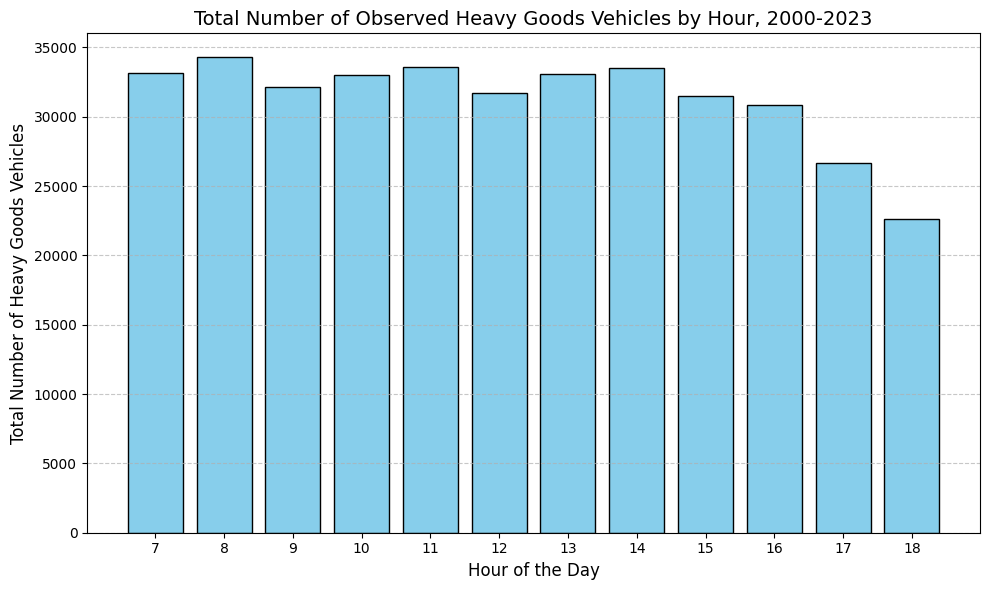

In [37]:
coordinates_of_points = border_points[["latitude", "longitude"]]

# Select the traffic at the count points we are interested in
border_traffic = pd.merge(data_traffic, coordinates_of_points, on=['latitude', 'longitude'], how = 'inner')

# Total traffic of heavy goods by hour, 2000-2023, at count points

# Group by 'hour' and calculate the average of 'all_hgvs'
hourly_avg_hgvs = border_traffic.groupby('hour')['all_hgvs'].sum().reset_index()

# Plot the histogram
plt.figure(figsize=(10, 6))
plt.bar(hourly_avg_hgvs['hour'], hourly_avg_hgvs['all_hgvs'], color='skyblue', edgecolor='black')

# Add labels and title
plt.xlabel('Hour of the Day', fontsize=12)
plt.ylabel('Total Number of Heavy Goods Vehicles', fontsize=12)
plt.title('Total Number of Observed Heavy Goods Vehicles by Hour, 2000-2023', fontsize=14)
plt.xticks(hourly_avg_hgvs['hour'], fontsize=10)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Display the plot
plt.tight_layout()
plt.show()

--- 

The histogram above yields two important insights:

🔺 From `7am to 5pm`, heavy goods vehicles traffic on the border stays `relatively constant`, with minor fluctuations.

🔺 From `5pm to 7pm`, we notice a `significant decrease` in heavy goods traffic, with an approximately `15%` decrease from `5pm to 6pm`, and another `15%` from `6pm to 7pm`.


🔺 This observation could be a consequence of a number of factors, including `peak delivery times` (traffic could peak earlier in the day when deliveries are scheduled, leaving less demand for crossings later in the day), `end-of-shift timing` (many logistics companies and warehouses finishing their shift at 5pm, resulting in fewer trucks heading toward the border), or even `regulations` on truck driver working hours.

--- 

## 3.3 Selecting and visualizing the checkpoints, i.e. the count points with an appropriate hgvs volume and number of observations 

✅ Among the previously determined locations in proximity to the border, some will have negligible hgvs traffic, and others will have only a few days where we observe traffic. Hence, in order to create an appropriate estimate for the amount of hgvs crossing the border each month and then, each year, we will need to select a robust subset of count points from which we will be able to create some meaningful estimations, i.e. checkpoints.

✅ Among the previously determined locations in proximity to the border, some will have negligible hgvs traffic, and others will have only a few days where we observe traffic. Hence, in order to create an appropriate estimate for the amount of hgvs crossing the border each month and then, each year, we will need to select a robust subset of count points from which we will be able to create some meaningful estimations, i.e. checkpoints.

✅ After determining these checkpoints, we will visualize them, using different-coloured labels to differentiate them by the average hgvs volume. 


---

First, let us select some concrete thresholds for the count points which pass appropriate thresholds to be considered checkpoints. We want observations on at least `3 different days` from 2000 to 2023, and an average hgvs traffic volume of at least `20 vehicles per hour`. We will save the count points which validate these chosen thresholds into 'border_points'.

In [38]:
# Re-initialize border traffic
border_traffic = pd.merge(data_traffic, coordinates_of_points, on=['latitude', 'longitude'], how = 'inner')

count_points_by_traffic_volume = border_traffic.groupby(['count_point_id'], group_keys=False)[['all_hgvs']].mean()

count_points_by_traffic_amount = border_traffic.groupby(['count_point_id'], group_keys=False)[['count_date']].count()

count_points_by_traffic_amount = count_points_by_traffic_amount.sort_values(by = ['count_date'])

count_points_by_traffic_volume = count_points_by_traffic_volume.sort_values(by = ['all_hgvs'], ascending=False)

count_points_by_traffic = pd.merge(count_points_by_traffic_volume, count_points_by_traffic_amount, on=['count_point_id'], how = 'inner')

# Check for the hgvs volume threshold
count_points_by_traffic = count_points_by_traffic[count_points_by_traffic['all_hgvs'] >= 20]

# Check for the different observations threshold
count_points_by_traffic = count_points_by_traffic[count_points_by_traffic['count_date'] >= 25]

count_points_by_traffic = count_points_by_traffic.drop(columns=['count_date'])

count_points_by_traffic = count_points_by_traffic.rename(columns={'all_hgvs': 'average_hgvs'})

# Restrict our analysis to traffic at the checkpoints
border_traffic = pd.merge(data_traffic, count_points_by_traffic, on=['count_point_id'], how='inner')

# List the checkpoints
border_points = border_traffic[['latitude', 'longitude', 'road_name', 'road_type', 'local_authority_id', 'local_authority_name', 'average_hgvs']]

border_points = border_points.drop_duplicates()

--- 

We now visualize these checkpoints, i.e. count points which pass the thresholds, on a map, colouring the pins differently based on the average observed traffic volume.

In [39]:
# Plotting inspired from:
# https://geopandas.org/en/stable/gallery/plotting_with_folium.html
# Accessed on 2 Dec 2024.


# Load into geopandas
geometry = gpd.points_from_xy(border_points.longitude, border_points.latitude)
geo_df = gpd.GeoDataFrame(
    border_points[["latitude", "longitude", "road_name", "road_type", "local_authority_id", "local_authority_name", "average_hgvs"]], geometry = geometry
)

# Initialize the map
map4 = folium.Map(location=[55.455, -3.010], tiles="OpenStreetMap", zoom_start = 9)

# Convert DataFrame to GeoDataFrame
geometry = gpd.points_from_xy(border_points.longitude, border_points.latitude)
geo_df = gpd.GeoDataFrame(
    border_points[["latitude", "longitude", "road_name", "road_type", "local_authority_id", "local_authority_name", "average_hgvs"]],
    geometry=geometry
)

# Initialize the map
map = folium.Map(location=[55.455, -3.010], tiles="OpenStreetMap", zoom_start=9)

# Iterate through the GeoDataFrame and add a marker for each geometry
for idx, row in geo_df.iterrows():
    if isinstance(row.geometry, Point):  # Ensure the geometry is a Point
        coordinates = [row.geometry.y, row.geometry.x]  # Extract coordinates
        if row.average_hgvs > 200:
            type_color = "red"
        elif row.average_hgvs > 100:
            type_color = "black"
        elif row.average_hgvs > 70:
            type_color = "purple"
        elif row.average_hgvs > 40:
            type_color = "green"
        else:
            type_color = "blue"

        # Add marker with popup labels
        folium.Marker(
            location=coordinates,
            popup=(
                f"Road Name: {row.road_name}<br>"
                f"Road Type: {row.road_type}<br>"
                f"Authority ID: {row.local_authority_id}<br>"
                f"Authority Name: {row.local_authority_name}<br>"
                f"Coordinates: {coordinates}"
            ),
            icon=folium.Icon(color=type_color),
        ).add_to(map)

In [40]:
map

--- 

📝 Something very interesting has happened! We notice a strong qualitative insight from analyzing the border checkpoints in this way; the border checkpoints can be partitioned into `4 different types` based on their average heavy goods traffic, matching almost perfectly to the road or highway used to cross the border:

🔺 `Type 1, Red` (Average hourly hgvs traffic volume > 200): These count points all lie on the `A74(M)`, and they absolutely dominate when it comes to heavy goods vehicles border crossings between England and Scotland. `Gretna` is by far the most important connection between the two constituent countries of the United Kingdom, facilitating the majority of logistical operations between Scotland's two greatest cities, `Edinburgh` and `Glasgow`, and the largest cities in Northern England, such as `Liverpool` and `Manchester`, and then further down to `Birmingham` and `London`.

🟣 `Type 2, Purple` (Average hourly hgvs traffic volume > 70, but < 100): These count points all lie on the `A75`, and they track precisely the hgvs which are also going to enter or leave Scotland through the `A74(M)`, like the `Type 1` count_points, but instead of continuing or leaving through the `A74`, take an alternative route via the `A75`, passing near the city of `Dumfries`, and constituting a secondary route to or from Scotland's largest city of `Glasgow`.

🟢 `Type 3, Green` (Average hourly hgvs traffic volume > 40, but < 70): These count points mostly lie on the opposite side of the country altogether, on the `A4`, and tracking the hgvs which enter or leave Scotland via `Berwick-upon-Tweed`. The overwhelming majority of these routes will serve the capital city of Scotland, `Edinburgh`, representing an alternative transportation route to the `A74(M)` which avoids going towards `Glasgow`. It is nonetheless an important artery of intra-British trade, connecting Scotland's capital to important English cities in the East of the country, such as `Newcastle upon Tyne`. Even so, from our data we can approximate its traffic to be approximately `5 to 6 times lower` than through the other side of the country, via the `A74(M)`.

🔵 `Type 4, Blue` (Average hourly hgvs traffic volume > 20, but < 40): The final category represents the count points which are mostly situated in the `middle` between the `A74(M)` and the `A4`, the two main highways of entry into the country. The roads corresponding to this category are the `A7` and the `A68`. Less than 10% of hgvs traffic utilizes these routes.

--- 

To further illustrate this organic differentiation that has arisen from the data let us also plot a pie chart, indicating average hourly traffic for the count points we are analyzing, grouped by road ('road_avg_hgvs' will come in useful in our estimations, done in the final sections):

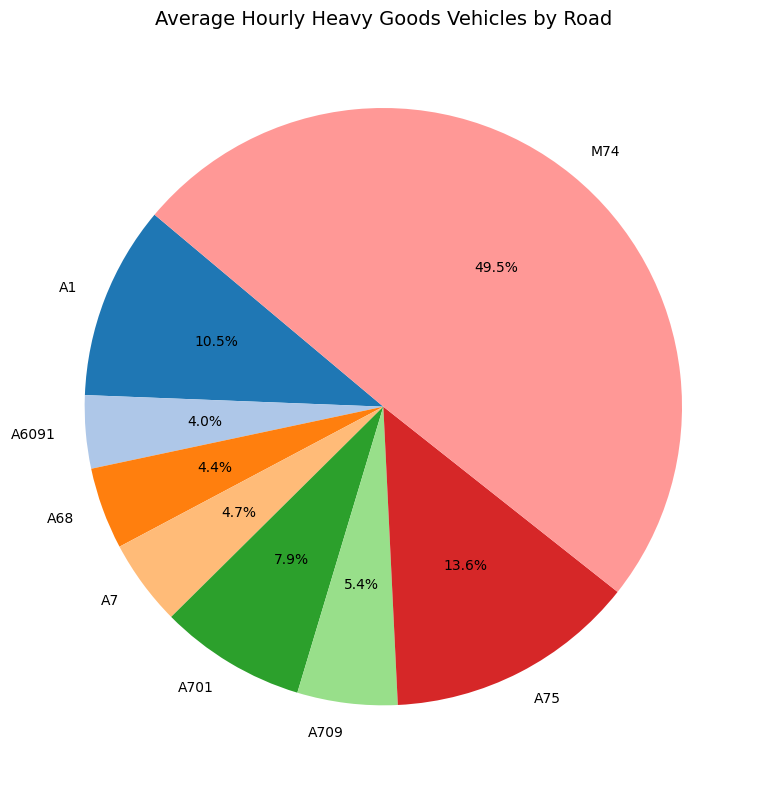

In [41]:
# Group by 'road_name' and calculate the mean of 'average_hgvs'
road_avg_hgvs = border_points.groupby('road_name')['average_hgvs'].mean()

# Plot the pie chart
plt.figure(figsize=(10, 8))
plt.pie(
    road_avg_hgvs, 
    labels=road_avg_hgvs.index, 
    autopct='%1.1f%%', 
    startangle=140, 
    colors=plt.cm.tab20.colors
)

# Add title
plt.title('Average Hourly Heavy Goods Vehicles by Road', fontsize=14)

# Display the pie chart
plt.tight_layout()
plt.show()

--- 

🔺 The pie chart confirms the observations described above, with entries via the `A74(M)` accounting for approximately `50%` of all heavy goods vehicles border crossings between England and Scotland.

--- 

## 3.4 Estimating and Visualizing hgvs traffic by Month and Year, from 2000 to 2023

### Methodology

✅ Considering the data extracted from the previous checkpoints we established previously, we estimate hgvs traffic volumes for each month starting from 2000 to 2023.

✅ We know however that count points vary significantly in the amount of vehicles they record, with count points on different roads counting significantly more hgvs than those on other roads. 

✅ With the assumption that the logistical architecture has remained roughly constant from 2000 to 2023 (i.e. the ratios between hgvs entering via different roads remain constant), we will consider some weights in order to normalize the observations in a given month with respect to what road those observations occured at. 

✅ We fill in the missing values by interpolating.

✅ Create the visualizations by month and year.

---

First of all, let's begin by creating the estimated observations for the M74 (representing 50% of total traffic) based on real tracking and weighted by the ratio of average hourly traffic between the road we are observing on and M74. 

We then aggregate by month and year.

In [42]:
# Traffic of heavy goods vehicles by year and month, 2000-2023


# Ensure count_date is in datetime format
border_traffic['count_date'] = pd.to_datetime(border_traffic['count_date'])

# Merge road_avg_hgvs with border_traffic on 'road_name'
border_traffic = border_traffic.merge(road_avg_hgvs, on='road_name', how='left', suffixes=('', '_weight'))

# Create the 'weighted_all_hgvs' column
border_traffic['weighted_all_hgvs'] = border_traffic['all_hgvs'] * 258.81 / border_traffic['average_hgvs']

# Create a 'month_year' column for grouping by month and year
border_traffic['month_year'] = border_traffic['count_date'].dt.to_period('M')

# Group by 'month_year' and aggregate
monthly_summary = border_traffic.groupby('month_year').agg(
    count_observations=('count_point_id', 'size'),           # Count the number of observations
    total_weighted_hgvs=('weighted_all_hgvs', 'sum')         # Sum of 'weighted_all_hgvs'
).reset_index()

# Convert 'month_year' back to datetime for better readability, if desired
monthly_summary['month_year'] = monthly_summary['month_year'].dt.to_timestamp()

monthly_summary['year'] = monthly_summary['month_year'].dt.year
monthly_summary['month'] = monthly_summary['month_year'].dt.month

monthly_summary = monthly_summary.iloc[:, [4, 3, 1, 2, 0]]

--- 

Now, for each month in the obtained aggregation we can determine total volume for that month!

🖥️ The formula can be determined as follows (M74 traffic, i.e. the value in total_weighted_hgvs, is 50% of all traffic, hence the factor of 2):

In [43]:

number_of_days = 30
number_of_hours = 20 #We assume night traffic is slightly lower than day traffic, hence adjust for number of hours
monthly_summary['total_volume'] = (monthly_summary['total_weighted_hgvs'] / monthly_summary['count_observations']) * 2 * number_of_days * number_of_hours

--- 

Finally, we use linear interpolation to fill in the missing values: 

In [44]:
# Drop the 'count_observations' and 'total_weighted_hgvs' columns
monthly_summary = monthly_summary.drop(columns=['count_observations', 'total_weighted_hgvs'])

# Ensure 'month' is a datetime object
monthly_summary['month_year'] = pd.to_datetime(monthly_summary['month_year'])

# Create a complete date range from January 2000 to December 2023
full_date_range = pd.date_range(start='2000-03-01', end='2023-12-01', freq='MS')  # Monthly start frequency

# Create a new DataFrame with the complete date range
full_monthly_summary = pd.DataFrame({'month_year': full_date_range})

# Merge the full date range with the original data
full_monthly_summary = pd.merge(full_monthly_summary, monthly_summary, on='month_year', how='left')

# Add a column to flag whether the value was interpolated
full_monthly_summary['was_interpolated'] = full_monthly_summary['total_volume'].isna()

# Interpolate missing values for 'total_volume'
full_monthly_summary['total_volume'] = full_monthly_summary['total_volume'].interpolate(method='linear')

# Extract the month, year from the date
full_monthly_summary['month'] = full_monthly_summary['month_year'].dt.month
full_monthly_summary['year'] = full_monthly_summary['month_year'].dt.year

# Display the resulting DataFrame
print(full_monthly_summary)

    month_year  month  year   total_volume  was_interpolated
0   2000-03-01      3  2000  334591.275422             False
1   2000-04-01      4  2000  325683.970709              True
2   2000-05-01      5  2000  316776.665995             False
3   2000-06-01      6  2000  357603.167435              True
4   2000-07-01      7  2000  398429.668875              True
..         ...    ...   ...            ...               ...
281 2023-08-01      8  2023  327781.530928              True
282 2023-09-01      9  2023  327781.530928              True
283 2023-10-01     10  2023  327781.530928              True
284 2023-11-01     11  2023  327781.530928              True
285 2023-12-01     12  2023  327781.530928              True

[286 rows x 5 columns]


---

🚀 Finally, it is time to create histograms that illustrate our estimates for the variation of total heavy goods vehicles traffic for the Anglo-Scottish Border across time and year, from 2000 to 2023!

--- 

First of all, we visualize the average monthly variation across 20 years, naturally expecting to not see much of a difference:


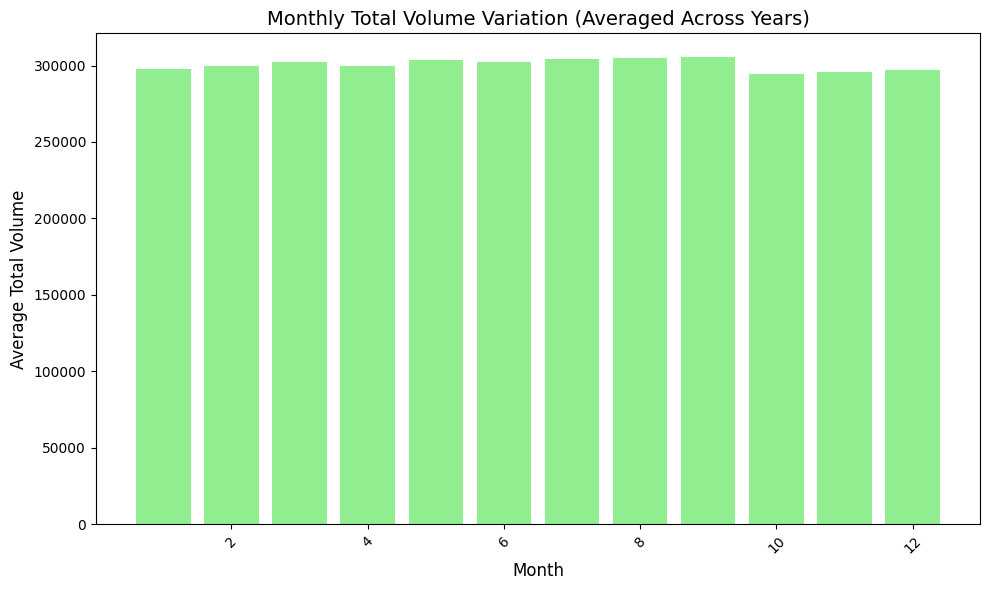

In [45]:
# Extract month names and group by month (ignoring years)
monthly_variation = full_monthly_summary.groupby('month')['total_volume'].mean()

# Histogram for variation by month
plt.figure(figsize=(10, 6))
plt.bar(monthly_variation.index, monthly_variation, color='lightgreen')
plt.xlabel('Month', fontsize=12)
plt.ylabel('Average Total Volume', fontsize=12)
plt.title('Monthly Total Volume Variation (Averaged Across Years)', fontsize=14)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

---

🔺 As expected, there is barely any variation across months when we average over a 20-year period, with only a minimal decrease in the last quarter of the year being the only noticeable trend in the graph.

---

💫 Finally, the most interesting part of this third section: the yearly variation of total traffic of heavy goods vehicles between England and Scotland!

Despite having a very limited amount of useful data for this task, and thus requiring a significant amount of estimation and interpolation in order to create estimates for each month we have data for, can we yet say something about yearly trends and total volume?

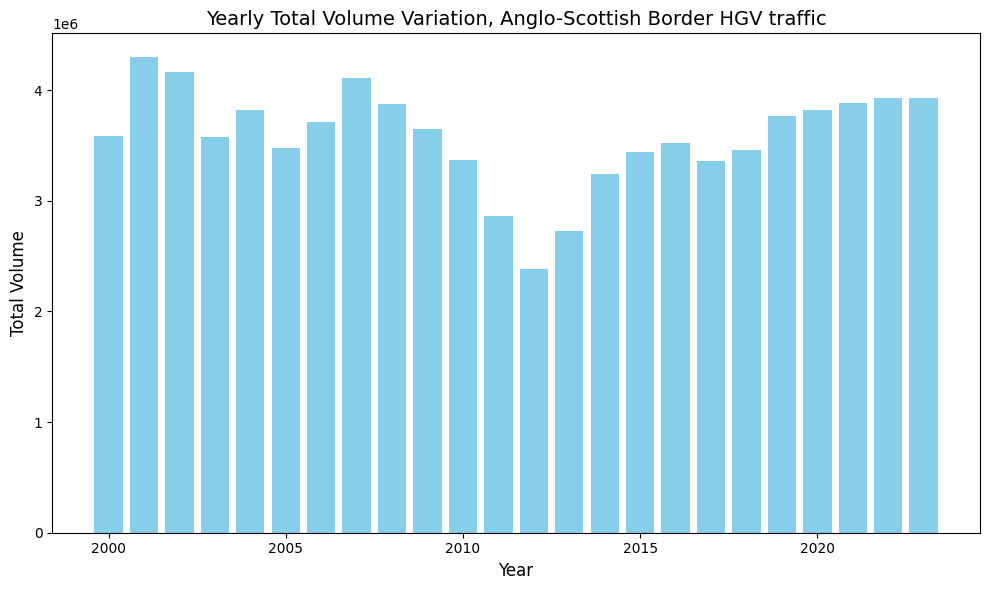

In [46]:
# Group by year and calculate total volume for each year
yearly_variation = full_monthly_summary.groupby('year')['total_volume'].sum()

# Histogram for variation by year
plt.figure(figsize=(10, 6))
plt.bar(yearly_variation.index, yearly_variation, color='skyblue')
plt.xlabel('Year', fontsize=12)
plt.ylabel('Total Volume', fontsize=12)
plt.title('Yearly Total Volume Variation, Anglo-Scottish Border HGV traffic', fontsize=14)
plt.tight_layout()
plt.show()

In [47]:
print(yearly_variation)

print(yearly_variation.mean())

year
2000    3.589306e+06
2001    4.299091e+06
2002    4.161806e+06
2003    3.572694e+06
2004    3.819539e+06
2005    3.473540e+06
2006    3.711936e+06
2007    4.114700e+06
2008    3.878572e+06
2009    3.649766e+06
2010    3.373509e+06
2011    2.867240e+06
2012    2.386512e+06
2013    2.723098e+06
2014    3.243865e+06
2015    3.442459e+06
2016    3.521871e+06
2017    3.359614e+06
2018    3.459642e+06
2019    3.766485e+06
2020    3.824535e+06
2021    3.882585e+06
2022    3.929347e+06
2023    3.933378e+06
Name: total_volume, dtype: float64
3582712.0427315156


--- 

## 3.5 Conclusion: It appears the data is saying something...

🔺 Using the previous results and estimates, it appears that we have arrived at the estimate that, on average, from 2000 to 2023, there were `3.58 million` heavy goods vehicles crossing the Anglo-Scottish border each year. We obtained that this was as high as `4.29 million` in `2001`, and as low as `2.38 million` in `2012`.

🔺 The overall trend was as follows: from `2000` to `2007`, the volume fluctuated constantly between `3.5 million` and `4 million`, then `steadily decreased` from `2008` to `2012`, when we had the lowest border traffic recorded in the 20-year period. After `2012`, traffic `steadily increased` again, until it reached pre-2008 levels.

🔺 We thus arrive at the main qualitative hypothesis spawned by this third investigation of the dataset:

## 📉 The Global Financial Crisis of 2007-2008 caused a steady year-to-year decrease of HGV traffic between England and Scotland from 2008 to 2012, down to 60% of the volume before the crash. 

## 📈 After 2012, volume began to steadily recover again, reaching pre-GFC levels by the end of the decade. 

---